# Afriat

In [1]:
scan=0.16

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: smbct67z
Name: tusken-parsec-138
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/smbct67z
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155911-smbct67z/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2552,3276,9415
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2552,2575,1697,3472,1600,3347
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4474,10769
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 653,833,2324
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 653,627,411,818,449,852
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1110,2700
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:22:20, 14.26s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:22:20, 14.26s/it, v_num=7z_1, total_loss_train=3.69e+3, kl_local_train=54.6]

Epoch 2/600:   0%|          | 1/600 [00:14<2:22:20, 14.26s/it, v_num=7z_1, total_loss_train=3.69e+3, kl_local_train=54.6]

Epoch 2/600:   0%|          | 2/600 [00:27<2:14:46, 13.52s/it, v_num=7z_1, total_loss_train=3.69e+3, kl_local_train=54.6]

Epoch 2/600:   0%|          | 2/600 [00:27<2:14:46, 13.52s/it, v_num=7z_1, total_loss_train=3.21e+3, kl_local_train=79.9]

Epoch 3/600:   0%|          | 2/600 [00:27<2:14:46, 13.52s/it, v_num=7z_1, total_loss_train=3.21e+3, kl_local_train=79.9]

Epoch 3/600:   0%|          | 3/600 [00:40<2:12:59, 13.37s/it, v_num=7z_1, total_loss_train=3.21e+3, kl_local_train=79.9]

Epoch 3/600:   0%|          | 3/600 [00:40<2:12:59, 13.37s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=81.3] 

Epoch 4/600:   0%|          | 3/600 [00:40<2:12:59, 13.37s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=81.3]

Epoch 4/600:   1%|          | 4/600 [00:53<2:12:44, 13.36s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=81.3]

Epoch 4/600:   1%|          | 4/600 [00:53<2:12:44, 13.36s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 4/600 [00:53<2:12:44, 13.36s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 5/600 [01:07<2:13:02, 13.42s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=78.3]

Epoch 5/600:   1%|          | 5/600 [01:07<2:13:02, 13.42s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=72.9]

Epoch 6/600:   1%|          | 5/600 [01:08<2:13:02, 13.42s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=72.9]

Epoch 6/600:   1%|          | 6/600 [01:21<2:15:21, 13.67s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=72.9]

Epoch 6/600:   1%|          | 6/600 [01:21<2:15:21, 13.67s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:21<2:15:21, 13.67s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:34<2:11:39, 13.32s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:34<2:11:39, 13.32s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=55, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]  

Epoch 8/600:   1%|          | 7/600 [01:34<2:11:39, 13.32s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=55, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:46<2:09:08, 13.09s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=55, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:46<2:09:08, 13.09s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:46<2:09:08, 13.09s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:59<2:06:42, 12.86s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:59<2:06:42, 12.86s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [01:59<2:06:42, 12.86s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:11<2:05:29, 12.76s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:11<2:05:29, 12.76s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=22.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035] 

Epoch 11/600:   2%|▏         | 10/600 [02:12<2:05:29, 12.76s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=22.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:25<2:07:49, 13.02s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=22.9, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.00697, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:25<2:07:49, 13.02s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=16.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 12/600:   2%|▏         | 11/600 [02:25<2:07:49, 13.02s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=16.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 12/600:   2%|▏         | 12/600 [02:37<2:05:26, 12.80s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=16.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 12/600:   2%|▏         | 12/600 [02:37<2:05:26, 12.80s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=18.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 13/600:   2%|▏         | 12/600 [02:37<2:05:26, 12.80s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=18.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 13/600:   2%|▏         | 13/600 [02:49<2:03:33, 12.63s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=18.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 13/600:   2%|▏         | 13/600 [02:49<2:03:33, 12.63s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=27.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 14/600:   2%|▏         | 13/600 [02:49<2:03:33, 12.63s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=27.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 14/600:   2%|▏         | 14/600 [03:01<2:01:41, 12.46s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=27.4, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 14/600:   2%|▏         | 14/600 [03:01<2:01:41, 12.46s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 15/600:   2%|▏         | 14/600 [03:01<2:01:41, 12.46s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 15/600:   2%|▎         | 15/600 [03:14<2:01:09, 12.43s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 15/600:   2%|▎         | 15/600 [03:14<2:01:09, 12.43s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=51, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]  

Epoch 16/600:   2%|▎         | 15/600 [03:15<2:01:09, 12.43s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=51, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 16/600:   3%|▎         | 16/600 [03:27<2:04:32, 12.80s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=51, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00794, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 16/600:   3%|▎         | 16/600 [03:27<2:04:32, 12.80s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=57.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 17/600:   3%|▎         | 16/600 [03:27<2:04:32, 12.80s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=57.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 17/600:   3%|▎         | 17/600 [03:39<2:02:34, 12.61s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=57.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 17/600:   3%|▎         | 17/600 [03:39<2:02:34, 12.61s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 18/600:   3%|▎         | 17/600 [03:39<2:02:34, 12.61s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 18/600:   3%|▎         | 18/600 [03:52<2:01:14, 12.50s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=65.2, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 18/600:   3%|▎         | 18/600 [03:52<2:01:14, 12.50s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=72.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 19/600:   3%|▎         | 18/600 [03:52<2:01:14, 12.50s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=72.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 19/600:   3%|▎         | 19/600 [04:04<2:00:19, 12.43s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=72.1, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 19/600:   3%|▎         | 19/600 [04:04<2:00:19, 12.43s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 20/600:   3%|▎         | 19/600 [04:04<2:00:19, 12.43s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 20/600:   3%|▎         | 20/600 [04:16<2:00:13, 12.44s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 20/600:   3%|▎         | 20/600 [04:16<2:00:13, 12.44s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=85.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 21/600:   3%|▎         | 20/600 [04:18<2:00:13, 12.44s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=85.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 21/600:   4%|▎         | 21/600 [04:30<2:02:55, 12.74s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=85.8, metric_mi|status_control_train=0.0241, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0233, metric_mi|mouse_train=0.0494]

Epoch 21/600:   4%|▎         | 21/600 [04:30<2:02:55, 12.74s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=93.3, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 22/600:   4%|▎         | 21/600 [04:30<2:02:55, 12.74s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=93.3, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 22/600:   4%|▎         | 22/600 [04:42<2:01:04, 12.57s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=93.3, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 22/600:   4%|▎         | 22/600 [04:42<2:01:04, 12.57s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=97.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 23/600:   4%|▎         | 22/600 [04:42<2:01:04, 12.57s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=97.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 23/600:   4%|▍         | 23/600 [04:54<2:00:04, 12.49s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=97.4, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 23/600:   4%|▍         | 23/600 [04:54<2:00:04, 12.49s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773] 

Epoch 24/600:   4%|▍         | 23/600 [04:54<2:00:04, 12.49s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 24/600:   4%|▍         | 24/600 [05:07<1:59:20, 12.43s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 24/600:   4%|▍         | 24/600 [05:07<1:59:20, 12.43s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 25/600:   4%|▍         | 24/600 [05:07<1:59:20, 12.43s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 25/600:   4%|▍         | 25/600 [05:19<1:59:03, 12.42s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=103, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 25/600:   4%|▍         | 25/600 [05:19<1:59:03, 12.42s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 26/600:   4%|▍         | 25/600 [05:20<1:59:03, 12.42s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 26/600:   4%|▍         | 26/600 [05:33<2:02:37, 12.82s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=107, metric_mi|status_control_train=0.0353, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0589, metric_mi|mouse_train=0.0773]

Epoch 26/600:   4%|▍         | 26/600 [05:33<2:02:37, 12.82s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 27/600:   4%|▍         | 26/600 [05:33<2:02:37, 12.82s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 27/600:   4%|▍         | 27/600 [05:45<2:00:43, 12.64s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 27/600:   4%|▍         | 27/600 [05:45<2:00:43, 12.64s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 28/600:   4%|▍         | 27/600 [05:45<2:00:43, 12.64s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 28/600:   5%|▍         | 28/600 [05:57<1:59:24, 12.53s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 28/600:   5%|▍         | 28/600 [05:57<1:59:24, 12.53s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 29/600:   5%|▍         | 28/600 [05:57<1:59:24, 12.53s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 29/600:   5%|▍         | 29/600 [06:10<1:58:23, 12.44s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=116, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 29/600:   5%|▍         | 29/600 [06:10<1:58:23, 12.44s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 30/600:   5%|▍         | 29/600 [06:10<1:58:23, 12.44s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 30/600:   5%|▌         | 30/600 [06:22<1:57:11, 12.34s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=111, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 30/600:   5%|▌         | 30/600 [06:22<1:57:11, 12.34s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 31/600:   5%|▌         | 30/600 [06:23<1:57:11, 12.34s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 31/600:   5%|▌         | 31/600 [06:35<2:00:53, 12.75s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=107, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0709, metric_mi|time_cat_train=0.0801, metric_mi|mouse_train=0.0934]

Epoch 31/600:   5%|▌         | 31/600 [06:35<2:00:53, 12.75s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]      

Epoch 32/600:   5%|▌         | 31/600 [06:35<2:00:53, 12.75s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 32/600:   5%|▌         | 32/600 [06:48<1:59:26, 12.62s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 32/600:   5%|▌         | 32/600 [06:48<1:59:26, 12.62s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 33/600:   5%|▌         | 32/600 [06:48<1:59:26, 12.62s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 33/600:   6%|▌         | 33/600 [07:00<1:58:27, 12.54s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 33/600:   6%|▌         | 33/600 [07:00<1:58:27, 12.54s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 33/600 [07:00<1:58:27, 12.54s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 34/600 [07:12<1:57:29, 12.45s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98.6, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 34/600 [07:12<1:57:29, 12.45s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 34/600 [07:12<1:57:29, 12.45s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 35/600 [07:25<1:57:00, 12.43s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 35/600 [07:25<1:57:00, 12.43s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=97.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 35/600 [07:26<1:57:00, 12.43s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=97.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 36/600 [07:38<2:00:12, 12.79s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=97.5, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 36/600 [07:38<2:00:12, 12.79s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=95.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 36/600 [07:38<2:00:12, 12.79s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=95.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [07:50<1:58:32, 12.63s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=95.8, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [07:51<1:58:32, 12.63s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]  

Epoch 38/600:   6%|▌         | 37/600 [07:51<1:58:32, 12.63s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [08:03<1:57:13, 12.51s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=98, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [08:03<1:57:13, 12.51s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=97.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 38/600 [08:03<1:57:13, 12.51s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=97.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [08:15<1:55:41, 12.37s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=97.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [08:15<1:55:41, 12.37s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 40/600:   6%|▋         | 39/600 [08:15<1:55:41, 12.37s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:27<1:55:16, 12.35s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:27<1:55:16, 12.35s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 40/600 [08:28<1:55:16, 12.35s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [08:41<1:58:38, 12.73s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [08:41<1:58:38, 12.73s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 41/600 [08:41<1:58:38, 12.73s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 42/600 [08:53<1:57:20, 12.62s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 42/600 [08:53<1:57:20, 12.62s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126] 

Epoch 43/600:   7%|▋         | 42/600 [08:53<1:57:20, 12.62s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 43/600 [09:05<1:54:46, 12.36s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 43/600 [09:05<1:54:46, 12.36s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 43/600 [09:05<1:54:46, 12.36s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 44/600 [09:16<1:51:35, 12.04s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 44/600 [09:16<1:51:35, 12.04s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 45/600:   7%|▋         | 44/600 [09:16<1:51:35, 12.04s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|▊         | 45/600 [09:27<1:49:16, 11.81s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|▊         | 45/600 [09:27<1:49:16, 11.81s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126] 

Epoch 46/600:   8%|▊         | 45/600 [09:29<1:49:16, 11.81s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 46/600 [09:40<1:51:56, 12.12s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=101, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 46/600 [09:40<1:51:56, 12.12s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|▊         | 46/600 [09:40<1:51:56, 12.12s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|▊         | 47/600 [09:52<1:49:28, 11.88s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 47/600:   8%|▊         | 47/600 [09:52<1:49:28, 11.88s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 47/600 [09:52<1:49:28, 11.88s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 48/600 [10:03<1:47:49, 11.72s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 48/600:   8%|▊         | 48/600 [10:03<1:47:49, 11.72s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 48/600 [10:03<1:47:49, 11.72s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 49/600 [10:14<1:46:28, 11.59s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=99.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 49/600:   8%|▊         | 49/600 [10:14<1:46:28, 11.59s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=97.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 49/600 [10:14<1:46:28, 11.59s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=97.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 50/600 [10:26<1:45:29, 11.51s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=97.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 50/600:   8%|▊         | 50/600 [10:26<1:45:29, 11.51s/it, v_num=7z_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 50/600 [10:27<1:45:29, 11.51s/it, v_num=7z_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 51/600 [10:38<1:48:05, 11.81s/it, v_num=7z_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.13]

Epoch 51/600:   8%|▊         | 51/600 [10:38<1:48:05, 11.81s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=98.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 52/600:   8%|▊         | 51/600 [10:38<1:48:05, 11.81s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=98.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|▊         | 52/600 [10:49<1:46:26, 11.65s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=98.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 52/600:   9%|▊         | 52/600 [10:49<1:46:26, 11.65s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=96.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▊         | 52/600 [10:49<1:46:26, 11.65s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=96.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▉         | 53/600 [11:01<1:45:10, 11.54s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=96.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 53/600:   9%|▉         | 53/600 [11:01<1:45:10, 11.54s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 53/600 [11:01<1:45:10, 11.54s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 54/600 [11:12<1:44:11, 11.45s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=96.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 54/600:   9%|▉         | 54/600 [11:12<1:44:11, 11.45s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=94.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 54/600 [11:12<1:44:11, 11.45s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=94.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 55/600 [11:23<1:43:37, 11.41s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=94.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 55/600:   9%|▉         | 55/600 [11:23<1:43:37, 11.41s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=93.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 55/600 [11:24<1:43:37, 11.41s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=93.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 56/600 [11:36<1:48:10, 11.93s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=93.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 56/600:   9%|▉         | 56/600 [11:36<1:48:10, 11.93s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 57/600:   9%|▉         | 56/600 [11:36<1:48:10, 11.93s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [11:49<1:49:23, 12.09s/it, v_num=7z_1, total_loss_train=3.2e+3, kl_local_train=93.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [11:49<1:49:23, 12.09s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 57/600 [11:49<1:49:23, 12.09s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [12:01<1:50:05, 12.19s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92.8, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [12:01<1:50:05, 12.19s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 58/600 [12:01<1:50:05, 12.19s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [12:13<1:49:45, 12.17s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92.4, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [12:13<1:49:45, 12.17s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]  

Epoch 60/600:  10%|▉         | 59/600 [12:13<1:49:45, 12.17s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [12:26<1:50:28, 12.28s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=92, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [12:26<1:50:28, 12.28s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=90.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 60/600 [12:27<1:50:28, 12.28s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=90.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [12:40<1:54:17, 12.72s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=90.2, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [12:40<1:54:17, 12.72s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=89.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|█         | 61/600 [12:40<1:54:17, 12.72s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=89.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|█         | 62/600 [12:52<1:53:28, 12.65s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=89.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|█         | 62/600 [12:52<1:53:28, 12.65s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|█         | 62/600 [12:52<1:53:28, 12.65s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|█         | 63/600 [13:05<1:52:49, 12.61s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=89.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|█         | 63/600 [13:05<1:52:49, 12.61s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 64/600:  10%|█         | 63/600 [13:05<1:52:49, 12.61s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 64/600:  11%|█         | 64/600 [13:17<1:52:18, 12.57s/it, v_num=7z_1, total_loss_train=3.19e+3, kl_local_train=88.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 64/600:  11%|█         | 64/600 [13:17<1:52:18, 12.57s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|█         | 64/600 [13:17<1:52:18, 12.57s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|█         | 65/600 [13:29<1:51:34, 12.51s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=88.3, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|█         | 65/600 [13:29<1:51:34, 12.51s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=88.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|█         | 65/600 [13:31<1:51:34, 12.51s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=88.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|█         | 66/600 [13:43<1:53:52, 12.79s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=88.8, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|█         | 66/600 [13:43<1:53:52, 12.79s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=87.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 67/600:  11%|█         | 66/600 [13:43<1:53:52, 12.79s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=87.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 67/600:  11%|█         | 67/600 [13:55<1:52:45, 12.69s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=87.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 67/600:  11%|█         | 67/600 [13:55<1:52:45, 12.69s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=87.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 68/600:  11%|█         | 67/600 [13:55<1:52:45, 12.69s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=87.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 68/600:  11%|█▏        | 68/600 [14:08<1:52:00, 12.63s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=87.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 68/600:  11%|█▏        | 68/600 [14:08<1:52:00, 12.63s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 69/600:  11%|█▏        | 68/600 [14:08<1:52:00, 12.63s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 69/600:  12%|█▏        | 69/600 [14:20<1:51:29, 12.60s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 69/600:  12%|█▏        | 69/600 [14:20<1:51:29, 12.60s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 70/600:  12%|█▏        | 69/600 [14:20<1:51:29, 12.60s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 70/600:  12%|█▏        | 70/600 [14:33<1:50:59, 12.57s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 70/600:  12%|█▏        | 70/600 [14:33<1:50:59, 12.57s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 71/600:  12%|█▏        | 70/600 [14:34<1:50:59, 12.57s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 71/600:  12%|█▏        | 71/600 [14:47<1:54:09, 12.95s/it, v_num=7z_1, total_loss_train=3.18e+3, kl_local_train=85.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.127]

Epoch 71/600:  12%|█▏        | 71/600 [14:47<1:54:09, 12.95s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]  

Epoch 72/600:  12%|█▏        | 71/600 [14:47<1:54:09, 12.95s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [14:59<1:52:32, 12.79s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [14:59<1:52:32, 12.79s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 72/600 [14:59<1:52:32, 12.79s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [15:11<1:50:38, 12.60s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [15:11<1:50:38, 12.60s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 73/600 [15:11<1:50:38, 12.60s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [15:24<1:50:11, 12.57s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.9, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [15:24<1:50:11, 12.57s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▏        | 74/600 [15:24<1:50:11, 12.57s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [15:36<1:49:41, 12.54s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.5, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [15:36<1:49:41, 12.54s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 76/600:  12%|█▎        | 75/600 [15:38<1:49:41, 12.54s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [15:50<1:52:45, 12.91s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=82.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [15:50<1:52:45, 12.91s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=81.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 77/600:  13%|█▎        | 76/600 [15:50<1:52:45, 12.91s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=81.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 77/600:  13%|█▎        | 77/600 [16:02<1:51:17, 12.77s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=81.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 77/600:  13%|█▎        | 77/600 [16:02<1:51:17, 12.77s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 78/600:  13%|█▎        | 77/600 [16:02<1:51:17, 12.77s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 78/600:  13%|█▎        | 78/600 [16:15<1:50:11, 12.67s/it, v_num=7z_1, total_loss_train=3.17e+3, kl_local_train=81.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 78/600:  13%|█▎        | 78/600 [16:15<1:50:11, 12.67s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 79/600:  13%|█▎        | 78/600 [16:15<1:50:11, 12.67s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 79/600:  13%|█▎        | 79/600 [16:27<1:49:05, 12.56s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=81.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 79/600:  13%|█▎        | 79/600 [16:27<1:49:05, 12.56s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 80/600:  13%|█▎        | 79/600 [16:27<1:49:05, 12.56s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 80/600:  13%|█▎        | 80/600 [16:39<1:47:55, 12.45s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=80.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 80/600:  13%|█▎        | 80/600 [16:39<1:47:55, 12.45s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 81/600:  13%|█▎        | 80/600 [16:41<1:47:55, 12.45s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 81/600:  14%|█▎        | 81/600 [16:53<1:51:04, 12.84s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=79.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 81/600:  14%|█▎        | 81/600 [16:53<1:51:04, 12.84s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=80, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121] 

Epoch 82/600:  14%|█▎        | 81/600 [16:53<1:51:04, 12.84s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=80, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 82/600:  14%|█▎        | 82/600 [17:06<1:49:46, 12.72s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=80, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 82/600:  14%|█▎        | 82/600 [17:06<1:49:46, 12.72s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=78.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 83/600:  14%|█▎        | 82/600 [17:06<1:49:46, 12.72s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=78.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 83/600:  14%|█▍        | 83/600 [17:18<1:48:58, 12.65s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=78.9, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 83/600:  14%|█▍        | 83/600 [17:18<1:48:58, 12.65s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 84/600:  14%|█▍        | 83/600 [17:18<1:48:58, 12.65s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 84/600:  14%|█▍        | 84/600 [17:30<1:48:15, 12.59s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=78.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 84/600:  14%|█▍        | 84/600 [17:30<1:48:15, 12.59s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 85/600:  14%|█▍        | 84/600 [17:31<1:48:15, 12.59s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 85/600:  14%|█▍        | 85/600 [17:43<1:46:50, 12.45s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=77.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 85/600:  14%|█▍        | 85/600 [17:43<1:46:50, 12.45s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 86/600:  14%|█▍        | 85/600 [17:44<1:46:50, 12.45s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 86/600:  14%|█▍        | 86/600 [17:56<1:50:05, 12.85s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.121]

Epoch 86/600:  14%|█▍        | 86/600 [17:56<1:50:05, 12.85s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 86/600 [17:56<1:50:05, 12.85s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 87/600 [18:09<1:48:40, 12.71s/it, v_num=7z_1, total_loss_train=3.16e+3, kl_local_train=77.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 87/600 [18:09<1:48:40, 12.71s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 88/600:  14%|█▍        | 87/600 [18:09<1:48:40, 12.71s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|█▍        | 88/600 [18:21<1:47:44, 12.63s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|█▍        | 88/600 [18:21<1:47:44, 12.63s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 88/600 [18:21<1:47:44, 12.63s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 89/600 [18:33<1:46:28, 12.50s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.4, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 89/600 [18:33<1:46:28, 12.50s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▍        | 89/600 [18:33<1:46:28, 12.50s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▌        | 90/600 [18:46<1:45:41, 12.43s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=76.1, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▌        | 90/600 [18:46<1:45:41, 12.43s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 90/600 [18:47<1:45:41, 12.43s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 91/600 [18:59<1:48:55, 12.84s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.191, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 91/600 [18:59<1:48:55, 12.84s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 92/600:  15%|█▌        | 91/600 [19:00<1:48:55, 12.84s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 92/600:  15%|█▌        | 92/600 [19:12<1:47:12, 12.66s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 92/600:  15%|█▌        | 92/600 [19:12<1:47:12, 12.66s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 93/600:  15%|█▌        | 92/600 [19:12<1:47:12, 12.66s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 93/600:  16%|█▌        | 93/600 [19:24<1:46:27, 12.60s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=75.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 93/600:  16%|█▌        | 93/600 [19:24<1:46:27, 12.60s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 94/600:  16%|█▌        | 93/600 [19:24<1:46:27, 12.60s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 94/600:  16%|█▌        | 94/600 [19:37<1:45:54, 12.56s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 94/600:  16%|█▌        | 94/600 [19:37<1:45:54, 12.56s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 95/600:  16%|█▌        | 94/600 [19:37<1:45:54, 12.56s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 95/600:  16%|█▌        | 95/600 [19:49<1:44:43, 12.44s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 95/600:  16%|█▌        | 95/600 [19:49<1:44:43, 12.44s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 96/600:  16%|█▌        | 95/600 [19:50<1:44:43, 12.44s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 96/600:  16%|█▌        | 96/600 [20:03<1:48:02, 12.86s/it, v_num=7z_1, total_loss_train=3.15e+3, kl_local_train=74.4, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.123]

Epoch 96/600:  16%|█▌        | 96/600 [20:03<1:48:02, 12.86s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12] 

Epoch 97/600:  16%|█▌        | 96/600 [20:03<1:48:02, 12.86s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 97/600 [20:15<1:47:00, 12.77s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=73.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 97/600:  16%|█▌        | 97/600 [20:15<1:47:00, 12.77s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▌        | 97/600 [20:15<1:47:00, 12.77s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▋        | 98/600 [20:28<1:46:08, 12.69s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 98/600:  16%|█▋        | 98/600 [20:28<1:46:08, 12.69s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 98/600 [20:28<1:46:08, 12.69s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 99/600 [20:40<1:45:23, 12.62s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.5, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 99/600:  16%|█▋        | 99/600 [20:40<1:45:23, 12.62s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 100/600:  16%|█▋        | 99/600 [20:40<1:45:23, 12.62s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 100/600:  17%|█▋        | 100/600 [20:52<1:44:24, 12.53s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 100/600:  17%|█▋        | 100/600 [20:52<1:44:24, 12.53s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 100/600 [20:54<1:44:24, 12.53s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 101/600 [21:06<1:47:42, 12.95s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=72.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.12]

Epoch 101/600:  17%|█▋        | 101/600 [21:06<1:47:42, 12.95s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 102/600:  17%|█▋        | 101/600 [21:06<1:47:42, 12.95s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 102/600:  17%|█▋        | 102/600 [21:19<1:45:29, 12.71s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 102/600:  17%|█▋        | 102/600 [21:19<1:45:29, 12.71s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 103/600:  17%|█▋        | 102/600 [21:19<1:45:29, 12.71s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 103/600:  17%|█▋        | 103/600 [21:31<1:44:46, 12.65s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 103/600:  17%|█▋        | 103/600 [21:31<1:44:46, 12.65s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]  

Epoch 104/600:  17%|█▋        | 103/600 [21:31<1:44:46, 12.65s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 104/600:  17%|█▋        | 104/600 [21:44<1:44:14, 12.61s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=71, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 104/600:  17%|█▋        | 104/600 [21:44<1:44:14, 12.61s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 105/600:  17%|█▋        | 104/600 [21:44<1:44:14, 12.61s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 105/600:  18%|█▊        | 105/600 [21:56<1:43:31, 12.55s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=70.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 105/600:  18%|█▊        | 105/600 [21:56<1:43:31, 12.55s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 106/600:  18%|█▊        | 105/600 [21:57<1:43:31, 12.55s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 106/600:  18%|█▊        | 106/600 [22:10<1:46:17, 12.91s/it, v_num=7z_1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.118]

Epoch 106/600:  18%|█▊        | 106/600 [22:10<1:46:17, 12.91s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 107/600:  18%|█▊        | 106/600 [22:10<1:46:17, 12.91s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 107/600:  18%|█▊        | 107/600 [22:22<1:44:14, 12.69s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=70.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 107/600:  18%|█▊        | 107/600 [22:22<1:44:14, 12.69s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 108/600:  18%|█▊        | 107/600 [22:22<1:44:14, 12.69s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 108/600:  18%|█▊        | 108/600 [22:34<1:43:21, 12.61s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 108/600:  18%|█▊        | 108/600 [22:34<1:43:21, 12.61s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 109/600:  18%|█▊        | 108/600 [22:34<1:43:21, 12.61s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 109/600:  18%|█▊        | 109/600 [22:47<1:42:35, 12.54s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 109/600:  18%|█▊        | 109/600 [22:47<1:42:35, 12.54s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 110/600:  18%|█▊        | 109/600 [22:47<1:42:35, 12.54s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 110/600:  18%|█▊        | 110/600 [22:59<1:41:59, 12.49s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.7, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 110/600:  18%|█▊        | 110/600 [22:59<1:41:59, 12.49s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 111/600:  18%|█▊        | 110/600 [23:00<1:41:59, 12.49s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 111/600:  18%|█▊        | 111/600 [23:13<1:44:53, 12.87s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.137, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.115]

Epoch 111/600:  18%|█▊        | 111/600 [23:13<1:44:53, 12.87s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114] 

Epoch 112/600:  18%|█▊        | 111/600 [23:13<1:44:53, 12.87s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 112/600:  19%|█▊        | 112/600 [23:25<1:43:29, 12.72s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=69.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 112/600:  19%|█▊        | 112/600 [23:25<1:43:29, 12.72s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 113/600:  19%|█▊        | 112/600 [23:25<1:43:29, 12.72s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 113/600:  19%|█▉        | 113/600 [23:37<1:41:57, 12.56s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 113/600:  19%|█▉        | 113/600 [23:37<1:41:57, 12.56s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 114/600:  19%|█▉        | 113/600 [23:37<1:41:57, 12.56s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 114/600:  19%|█▉        | 114/600 [23:50<1:41:23, 12.52s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 114/600:  19%|█▉        | 114/600 [23:50<1:41:23, 12.52s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 115/600:  19%|█▉        | 114/600 [23:50<1:41:23, 12.52s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 115/600:  19%|█▉        | 115/600 [24:02<1:40:49, 12.47s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 115/600:  19%|█▉        | 115/600 [24:02<1:40:49, 12.47s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]  

Epoch 116/600:  19%|█▉        | 115/600 [24:04<1:40:49, 12.47s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 116/600:  19%|█▉        | 116/600 [24:16<1:43:40, 12.85s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=68, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.114]

Epoch 116/600:  19%|█▉        | 116/600 [24:16<1:43:40, 12.85s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 117/600:  19%|█▉        | 116/600 [24:16<1:43:40, 12.85s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 117/600:  20%|█▉        | 117/600 [24:28<1:41:50, 12.65s/it, v_num=7z_1, total_loss_train=3.13e+3, kl_local_train=67.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 117/600:  20%|█▉        | 117/600 [24:28<1:41:50, 12.65s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|█▉        | 117/600 [24:28<1:41:50, 12.65s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|█▉        | 118/600 [24:41<1:41:01, 12.57s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 118/600:  20%|█▉        | 118/600 [24:41<1:41:01, 12.57s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|█▉        | 118/600 [24:41<1:41:01, 12.57s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|█▉        | 119/600 [24:53<1:40:27, 12.53s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 119/600:  20%|█▉        | 119/600 [24:53<1:40:27, 12.53s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|█▉        | 119/600 [24:53<1:40:27, 12.53s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|██        | 120/600 [25:05<1:40:09, 12.52s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 120/600:  20%|██        | 120/600 [25:05<1:40:09, 12.52s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|██        | 120/600 [25:07<1:40:09, 12.52s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|██        | 121/600 [25:19<1:42:45, 12.87s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 121/600:  20%|██        | 121/600 [25:19<1:42:45, 12.87s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|██        | 121/600 [25:19<1:42:45, 12.87s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|██        | 122/600 [25:31<1:40:53, 12.66s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=66.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|██        | 122/600 [25:31<1:40:53, 12.66s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|██        | 122/600 [25:31<1:40:53, 12.66s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|██        | 123/600 [25:44<1:40:17, 12.62s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|██        | 123/600 [25:44<1:40:17, 12.62s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 124/600:  20%|██        | 123/600 [25:44<1:40:17, 12.62s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|██        | 124/600 [25:56<1:39:29, 12.54s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|██        | 124/600 [25:56<1:39:29, 12.54s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|██        | 124/600 [25:56<1:39:29, 12.54s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|██        | 125/600 [26:09<1:38:56, 12.50s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|██        | 125/600 [26:09<1:38:56, 12.50s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|██        | 125/600 [26:10<1:38:56, 12.50s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|██        | 126/600 [26:22<1:41:43, 12.88s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|██        | 126/600 [26:22<1:41:43, 12.88s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111] 

Epoch 127/600:  21%|██        | 126/600 [26:22<1:41:43, 12.88s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|██        | 127/600 [26:34<1:39:48, 12.66s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|██        | 127/600 [26:35<1:39:48, 12.66s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|██        | 127/600 [26:35<1:39:48, 12.66s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|██▏       | 128/600 [26:47<1:39:05, 12.60s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|██▏       | 128/600 [26:47<1:39:05, 12.60s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 129/600:  21%|██▏       | 128/600 [26:47<1:39:05, 12.60s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 129/600:  22%|██▏       | 129/600 [26:59<1:38:28, 12.54s/it, v_num=7z_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 129/600:  22%|██▏       | 129/600 [26:59<1:38:28, 12.54s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|██▏       | 129/600 [26:59<1:38:28, 12.54s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|██▏       | 130/600 [27:12<1:37:52, 12.50s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|██▏       | 130/600 [27:12<1:37:52, 12.50s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|██▏       | 130/600 [27:13<1:37:52, 12.50s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|██▏       | 131/600 [27:25<1:40:34, 12.87s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|██▏       | 131/600 [27:25<1:40:34, 12.87s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 132/600:  22%|██▏       | 131/600 [27:25<1:40:34, 12.87s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 132/600:  22%|██▏       | 132/600 [27:38<1:39:23, 12.74s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 132/600:  22%|██▏       | 132/600 [27:38<1:39:23, 12.74s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]  

Epoch 133/600:  22%|██▏       | 132/600 [27:38<1:39:23, 12.74s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 133/600:  22%|██▏       | 133/600 [27:50<1:37:54, 12.58s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 133/600:  22%|██▏       | 133/600 [27:50<1:37:54, 12.58s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 134/600:  22%|██▏       | 133/600 [27:50<1:37:54, 12.58s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 134/600:  22%|██▏       | 134/600 [28:03<1:37:14, 12.52s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 134/600:  22%|██▏       | 134/600 [28:03<1:37:14, 12.52s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 135/600:  22%|██▏       | 134/600 [28:03<1:37:14, 12.52s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 135/600:  22%|██▎       | 135/600 [28:15<1:36:40, 12.47s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 135/600:  22%|██▎       | 135/600 [28:15<1:36:40, 12.47s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 136/600:  22%|██▎       | 135/600 [28:16<1:36:40, 12.47s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 136/600:  23%|██▎       | 136/600 [28:29<1:39:27, 12.86s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.108]

Epoch 136/600:  23%|██▎       | 136/600 [28:29<1:39:27, 12.86s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 137/600:  23%|██▎       | 136/600 [28:29<1:39:27, 12.86s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 137/600:  23%|██▎       | 137/600 [28:41<1:38:14, 12.73s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 137/600:  23%|██▎       | 137/600 [28:41<1:38:14, 12.73s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 138/600:  23%|██▎       | 137/600 [28:41<1:38:14, 12.73s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 138/600:  23%|██▎       | 138/600 [28:53<1:36:45, 12.57s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 138/600:  23%|██▎       | 138/600 [28:53<1:36:45, 12.57s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 139/600:  23%|██▎       | 138/600 [28:53<1:36:45, 12.57s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 139/600:  23%|██▎       | 139/600 [29:06<1:36:12, 12.52s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 139/600:  23%|██▎       | 139/600 [29:06<1:36:12, 12.52s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 140/600:  23%|██▎       | 139/600 [29:06<1:36:12, 12.52s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 140/600:  23%|██▎       | 140/600 [29:18<1:35:41, 12.48s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 140/600:  23%|██▎       | 140/600 [29:18<1:35:41, 12.48s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 141/600:  23%|██▎       | 140/600 [29:19<1:35:41, 12.48s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 141/600:  24%|██▎       | 141/600 [29:32<1:38:23, 12.86s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 141/600:  24%|██▎       | 141/600 [29:32<1:38:23, 12.86s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 142/600:  24%|██▎       | 141/600 [29:32<1:38:23, 12.86s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 142/600:  24%|██▎       | 142/600 [29:44<1:37:13, 12.74s/it, v_num=7z_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 142/600:  24%|██▎       | 142/600 [29:44<1:37:13, 12.74s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106] 

Epoch 143/600:  24%|██▎       | 142/600 [29:44<1:37:13, 12.74s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 143/600:  24%|██▍       | 143/600 [29:57<1:36:24, 12.66s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 143/600:  24%|██▍       | 143/600 [29:57<1:36:24, 12.66s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 144/600:  24%|██▍       | 143/600 [29:57<1:36:24, 12.66s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 144/600:  24%|██▍       | 144/600 [30:09<1:35:58, 12.63s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=62.1, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 144/600:  24%|██▍       | 144/600 [30:09<1:35:58, 12.63s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 145/600:  24%|██▍       | 144/600 [30:09<1:35:58, 12.63s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 145/600:  24%|██▍       | 145/600 [30:22<1:34:52, 12.51s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.8, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 145/600:  24%|██▍       | 145/600 [30:22<1:34:52, 12.51s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 146/600:  24%|██▍       | 145/600 [30:23<1:34:52, 12.51s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 146/600:  24%|██▍       | 146/600 [30:35<1:37:10, 12.84s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 146/600:  24%|██▍       | 146/600 [30:35<1:37:10, 12.84s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105] 

Epoch 147/600:  24%|██▍       | 146/600 [30:35<1:37:10, 12.84s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|██▍       | 147/600 [30:48<1:36:13, 12.74s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 147/600:  24%|██▍       | 147/600 [30:48<1:36:13, 12.74s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 148/600:  24%|██▍       | 147/600 [30:48<1:36:13, 12.74s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 148/600:  25%|██▍       | 148/600 [31:00<1:35:26, 12.67s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 148/600:  25%|██▍       | 148/600 [31:00<1:35:26, 12.67s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|██▍       | 148/600 [31:00<1:35:26, 12.67s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|██▍       | 149/600 [31:13<1:34:43, 12.60s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 149/600:  25%|██▍       | 149/600 [31:13<1:34:43, 12.60s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|██▍       | 149/600 [31:13<1:34:43, 12.60s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|██▌       | 150/600 [31:25<1:34:04, 12.54s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 150/600:  25%|██▌       | 150/600 [31:25<1:34:04, 12.54s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|██▌       | 150/600 [31:26<1:34:04, 12.54s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|██▌       | 151/600 [31:38<1:35:59, 12.83s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.105]

Epoch 151/600:  25%|██▌       | 151/600 [31:38<1:35:59, 12.83s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 151/600 [31:39<1:35:59, 12.83s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 152/600 [31:51<1:34:57, 12.72s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 152/600:  25%|██▌       | 152/600 [31:51<1:34:57, 12.72s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 153/600:  25%|██▌       | 152/600 [31:51<1:34:57, 12.72s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██▌       | 153/600 [32:03<1:34:16, 12.65s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 153/600:  26%|██▌       | 153/600 [32:03<1:34:16, 12.65s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 153/600 [32:03<1:34:16, 12.65s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 154/600 [32:16<1:33:37, 12.60s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 154/600:  26%|██▌       | 154/600 [32:16<1:33:37, 12.60s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 154/600 [32:16<1:33:37, 12.60s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 155/600 [32:28<1:33:01, 12.54s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=60.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 155/600:  26%|██▌       | 155/600 [32:28<1:33:01, 12.54s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 155/600 [32:30<1:33:01, 12.54s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 156/600 [32:42<1:35:37, 12.92s/it, v_num=7z_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 156/600:  26%|██▌       | 156/600 [32:42<1:35:37, 12.92s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|██▌       | 156/600 [32:42<1:35:37, 12.92s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|██▌       | 157/600 [32:55<1:34:14, 12.76s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=60.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 157/600:  26%|██▌       | 157/600 [32:55<1:34:14, 12.76s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|██▌       | 157/600 [32:55<1:34:14, 12.76s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|██▋       | 158/600 [33:07<1:33:09, 12.65s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 158/600:  26%|██▋       | 158/600 [33:07<1:33:09, 12.65s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|██▋       | 158/600 [33:07<1:33:09, 12.65s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|██▋       | 159/600 [33:19<1:32:42, 12.61s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 159/600:  26%|██▋       | 159/600 [33:19<1:32:42, 12.61s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 160/600:  26%|██▋       | 159/600 [33:19<1:32:42, 12.61s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 160/600:  27%|██▋       | 160/600 [33:32<1:32:05, 12.56s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.6, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 160/600:  27%|██▋       | 160/600 [33:32<1:32:05, 12.56s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|██▋       | 160/600 [33:33<1:32:05, 12.56s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|██▋       | 161/600 [33:46<1:34:41, 12.94s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.3, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.102]

Epoch 161/600:  27%|██▋       | 161/600 [33:46<1:34:41, 12.94s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]  

Epoch 162/600:  27%|██▋       | 161/600 [33:46<1:34:41, 12.94s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 162/600:  27%|██▋       | 162/600 [33:58<1:33:31, 12.81s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 162/600:  27%|██▋       | 162/600 [33:58<1:33:31, 12.81s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 163/600:  27%|██▋       | 162/600 [33:58<1:33:31, 12.81s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 163/600:  27%|██▋       | 163/600 [34:11<1:32:45, 12.74s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 163/600:  27%|██▋       | 163/600 [34:11<1:32:45, 12.74s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 164/600:  27%|██▋       | 163/600 [34:11<1:32:45, 12.74s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 164/600:  27%|██▋       | 164/600 [34:23<1:32:12, 12.69s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 164/600:  27%|██▋       | 164/600 [34:23<1:32:12, 12.69s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 165/600:  27%|██▋       | 164/600 [34:23<1:32:12, 12.69s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 165/600:  28%|██▊       | 165/600 [34:36<1:31:26, 12.61s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 165/600:  28%|██▊       | 165/600 [34:36<1:31:26, 12.61s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 166/600:  28%|██▊       | 165/600 [34:37<1:31:26, 12.61s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 166/600:  28%|██▊       | 166/600 [34:50<1:34:04, 13.01s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.8, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 166/600:  28%|██▊       | 166/600 [34:50<1:34:04, 13.01s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 167/600:  28%|██▊       | 166/600 [34:50<1:34:04, 13.01s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 167/600:  28%|██▊       | 167/600 [35:02<1:32:18, 12.79s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 167/600:  28%|██▊       | 167/600 [35:02<1:32:18, 12.79s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 168/600:  28%|██▊       | 167/600 [35:02<1:32:18, 12.79s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 168/600:  28%|██▊       | 168/600 [35:15<1:31:38, 12.73s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 168/600:  28%|██▊       | 168/600 [35:15<1:31:38, 12.73s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 169/600:  28%|██▊       | 168/600 [35:15<1:31:38, 12.73s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 169/600:  28%|██▊       | 169/600 [35:27<1:30:59, 12.67s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 169/600:  28%|██▊       | 169/600 [35:27<1:30:59, 12.67s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 170/600:  28%|██▊       | 169/600 [35:27<1:30:59, 12.67s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 170/600:  28%|██▊       | 170/600 [35:40<1:30:33, 12.64s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 170/600:  28%|██▊       | 170/600 [35:40<1:30:33, 12.64s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 171/600:  28%|██▊       | 170/600 [35:41<1:30:33, 12.64s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 171/600:  28%|██▊       | 171/600 [35:54<1:33:03, 13.02s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0994, metric_mi|mouse_train=0.101]

Epoch 171/600:  28%|██▊       | 171/600 [35:54<1:33:03, 13.02s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]    

Epoch 172/600:  28%|██▊       | 171/600 [35:54<1:33:03, 13.02s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 172/600:  29%|██▊       | 172/600 [36:06<1:31:57, 12.89s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 172/600:  29%|██▊       | 172/600 [36:06<1:31:57, 12.89s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 173/600:  29%|██▊       | 172/600 [36:06<1:31:57, 12.89s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 173/600:  29%|██▉       | 173/600 [36:19<1:30:57, 12.78s/it, v_num=7z_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 173/600:  29%|██▉       | 173/600 [36:19<1:30:57, 12.78s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]  

Epoch 174/600:  29%|██▉       | 173/600 [36:19<1:30:57, 12.78s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 174/600:  29%|██▉       | 174/600 [36:31<1:30:19, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=58, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 174/600:  29%|██▉       | 174/600 [36:31<1:30:19, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 175/600:  29%|██▉       | 174/600 [36:31<1:30:19, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 175/600:  29%|██▉       | 175/600 [36:44<1:29:49, 12.68s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 175/600:  29%|██▉       | 175/600 [36:44<1:29:49, 12.68s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 176/600:  29%|██▉       | 175/600 [36:45<1:29:49, 12.68s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 176/600:  29%|██▉       | 176/600 [36:58<1:32:11, 13.05s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.101]

Epoch 176/600:  29%|██▉       | 176/600 [36:58<1:32:11, 13.05s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 177/600:  29%|██▉       | 176/600 [36:58<1:32:11, 13.05s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 177/600:  30%|██▉       | 177/600 [37:10<1:30:47, 12.88s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 177/600:  30%|██▉       | 177/600 [37:10<1:30:47, 12.88s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 178/600:  30%|██▉       | 177/600 [37:10<1:30:47, 12.88s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 178/600:  30%|██▉       | 178/600 [37:23<1:29:29, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 178/600:  30%|██▉       | 178/600 [37:23<1:29:29, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]  

Epoch 179/600:  30%|██▉       | 178/600 [37:23<1:29:29, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 179/600:  30%|██▉       | 179/600 [37:35<1:29:02, 12.69s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 179/600:  30%|██▉       | 179/600 [37:35<1:29:02, 12.69s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 180/600:  30%|██▉       | 179/600 [37:35<1:29:02, 12.69s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 180/600:  30%|███       | 180/600 [37:48<1:28:22, 12.62s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 180/600:  30%|███       | 180/600 [37:48<1:28:22, 12.62s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 181/600:  30%|███       | 180/600 [37:49<1:28:22, 12.62s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 181/600:  30%|███       | 181/600 [38:02<1:31:14, 13.07s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0986, metric_mi|mouse_train=0.0997]

Epoch 181/600:  30%|███       | 181/600 [38:02<1:31:14, 13.07s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993] 

Epoch 182/600:  30%|███       | 181/600 [38:02<1:31:14, 13.07s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 182/600:  30%|███       | 182/600 [38:14<1:29:18, 12.82s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 182/600:  30%|███       | 182/600 [38:14<1:29:18, 12.82s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 183/600:  30%|███       | 182/600 [38:14<1:29:18, 12.82s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 183/600:  30%|███       | 183/600 [38:27<1:28:38, 12.75s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 183/600:  30%|███       | 183/600 [38:27<1:28:38, 12.75s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 184/600:  30%|███       | 183/600 [38:27<1:28:38, 12.75s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 184/600:  31%|███       | 184/600 [38:39<1:28:01, 12.70s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 184/600:  31%|███       | 184/600 [38:39<1:28:01, 12.70s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 185/600:  31%|███       | 184/600 [38:39<1:28:01, 12.70s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 185/600:  31%|███       | 185/600 [38:52<1:27:37, 12.67s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 185/600:  31%|███       | 185/600 [38:52<1:27:37, 12.67s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 186/600:  31%|███       | 185/600 [38:53<1:27:37, 12.67s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 186/600:  31%|███       | 186/600 [39:06<1:29:39, 12.99s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.5, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.0993]

Epoch 186/600:  31%|███       | 186/600 [39:06<1:29:39, 12.99s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 187/600:  31%|███       | 186/600 [39:06<1:29:39, 12.99s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 187/600:  31%|███       | 187/600 [39:18<1:28:33, 12.87s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 187/600:  31%|███       | 187/600 [39:18<1:28:33, 12.87s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 188/600:  31%|███       | 187/600 [39:18<1:28:33, 12.87s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 188/600:  31%|███▏      | 188/600 [39:31<1:27:44, 12.78s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 188/600:  31%|███▏      | 188/600 [39:31<1:27:44, 12.78s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]  

Epoch 189/600:  31%|███▏      | 188/600 [39:31<1:27:44, 12.78s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 189/600:  32%|███▏      | 189/600 [39:43<1:27:07, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 189/600:  32%|███▏      | 189/600 [39:43<1:27:07, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 190/600:  32%|███▏      | 189/600 [39:43<1:27:07, 12.72s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 190/600:  32%|███▏      | 190/600 [39:56<1:26:33, 12.67s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 190/600:  32%|███▏      | 190/600 [39:56<1:26:33, 12.67s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]  

Epoch 191/600:  32%|███▏      | 190/600 [39:57<1:26:33, 12.67s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 191/600:  32%|███▏      | 191/600 [40:10<1:28:53, 13.04s/it, v_num=7z_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0972, metric_mi|mouse_train=0.0986]

Epoch 191/600:  32%|███▏      | 191/600 [40:10<1:28:53, 13.04s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 192/600:  32%|███▏      | 191/600 [40:10<1:28:53, 13.04s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 192/600:  32%|███▏      | 192/600 [40:22<1:27:42, 12.90s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 192/600:  32%|███▏      | 192/600 [40:22<1:27:42, 12.90s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 193/600:  32%|███▏      | 192/600 [40:22<1:27:42, 12.90s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 193/600:  32%|███▏      | 193/600 [40:35<1:27:00, 12.83s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 193/600:  32%|███▏      | 193/600 [40:35<1:27:00, 12.83s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 194/600:  32%|███▏      | 193/600 [40:35<1:27:00, 12.83s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 194/600:  32%|███▏      | 194/600 [40:48<1:26:19, 12.76s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 194/600:  32%|███▏      | 194/600 [40:48<1:26:19, 12.76s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 195/600:  32%|███▏      | 194/600 [40:48<1:26:19, 12.76s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 195/600:  32%|███▎      | 195/600 [41:00<1:25:37, 12.68s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 195/600:  32%|███▎      | 195/600 [41:00<1:25:37, 12.68s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 196/600:  32%|███▎      | 195/600 [41:01<1:25:37, 12.68s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 196/600:  33%|███▎      | 196/600 [41:14<1:27:25, 12.98s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.0984]

Epoch 196/600:  33%|███▎      | 196/600 [41:14<1:27:25, 12.98s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 197/600:  33%|███▎      | 196/600 [41:14<1:27:25, 12.98s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 197/600:  33%|███▎      | 197/600 [41:25<1:24:09, 12.53s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 197/600:  33%|███▎      | 197/600 [41:25<1:24:09, 12.53s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 198/600:  33%|███▎      | 197/600 [41:25<1:24:09, 12.53s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 198/600:  33%|███▎      | 198/600 [41:37<1:21:27, 12.16s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 198/600:  33%|███▎      | 198/600 [41:37<1:21:27, 12.16s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 199/600:  33%|███▎      | 198/600 [41:37<1:21:27, 12.16s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 199/600:  33%|███▎      | 199/600 [41:48<1:19:32, 11.90s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 199/600:  33%|███▎      | 199/600 [41:48<1:19:32, 11.90s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]  

Epoch 200/600:  33%|███▎      | 199/600 [41:48<1:19:32, 11.90s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 200/600:  33%|███▎      | 200/600 [41:59<1:18:09, 11.72s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 200/600:  33%|███▎      | 200/600 [41:59<1:18:09, 11.72s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 201/600:  33%|███▎      | 200/600 [42:00<1:18:09, 11.72s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 201/600:  34%|███▎      | 201/600 [42:12<1:19:37, 11.97s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0975, metric_mi|mouse_train=0.0986]

Epoch 201/600:  34%|███▎      | 201/600 [42:12<1:19:37, 11.97s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 202/600:  34%|███▎      | 201/600 [42:12<1:19:37, 11.97s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 202/600:  34%|███▎      | 202/600 [42:23<1:18:04, 11.77s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 202/600:  34%|███▎      | 202/600 [42:23<1:18:04, 11.77s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 203/600:  34%|███▎      | 202/600 [42:23<1:18:04, 11.77s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 203/600:  34%|███▍      | 203/600 [42:34<1:17:19, 11.69s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 203/600:  34%|███▍      | 203/600 [42:34<1:17:19, 11.69s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 204/600:  34%|███▍      | 203/600 [42:34<1:17:19, 11.69s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 204/600:  34%|███▍      | 204/600 [42:46<1:17:02, 11.67s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 204/600:  34%|███▍      | 204/600 [42:46<1:17:02, 11.67s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 205/600:  34%|███▍      | 204/600 [42:46<1:17:02, 11.67s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 205/600:  34%|███▍      | 205/600 [42:58<1:16:53, 11.68s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 205/600:  34%|███▍      | 205/600 [42:58<1:16:53, 11.68s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 206/600:  34%|███▍      | 205/600 [42:59<1:16:53, 11.68s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 206/600:  34%|███▍      | 206/600 [43:11<1:19:48, 12.15s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.0984]

Epoch 206/600:  34%|███▍      | 206/600 [43:11<1:19:48, 12.15s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978] 

Epoch 207/600:  34%|███▍      | 206/600 [43:11<1:19:48, 12.15s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 207/600:  34%|███▍      | 207/600 [43:23<1:20:07, 12.23s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 207/600:  34%|███▍      | 207/600 [43:23<1:20:07, 12.23s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 208/600:  34%|███▍      | 207/600 [43:24<1:20:07, 12.23s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 208/600:  35%|███▍      | 208/600 [43:36<1:20:20, 12.30s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 208/600:  35%|███▍      | 208/600 [43:36<1:20:20, 12.30s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]  

Epoch 209/600:  35%|███▍      | 208/600 [43:36<1:20:20, 12.30s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 209/600:  35%|███▍      | 209/600 [43:48<1:20:14, 12.31s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 209/600:  35%|███▍      | 209/600 [43:48<1:20:14, 12.31s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 210/600:  35%|███▍      | 209/600 [43:48<1:20:14, 12.31s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 210/600:  35%|███▌      | 210/600 [44:00<1:19:45, 12.27s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 210/600:  35%|███▌      | 210/600 [44:00<1:19:45, 12.27s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]  

Epoch 211/600:  35%|███▌      | 210/600 [44:02<1:19:45, 12.27s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 211/600:  35%|███▌      | 211/600 [44:14<1:22:18, 12.70s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.096, metric_mi|time_cat_train=0.096, metric_mi|mouse_train=0.0978]

Epoch 211/600:  35%|███▌      | 211/600 [44:14<1:22:18, 12.70s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 212/600:  35%|███▌      | 211/600 [44:14<1:22:18, 12.70s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 212/600:  35%|███▌      | 212/600 [44:27<1:21:38, 12.62s/it, v_num=7z_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 212/600:  35%|███▌      | 212/600 [44:27<1:21:38, 12.62s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 213/600:  35%|███▌      | 212/600 [44:27<1:21:38, 12.62s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 213/600:  36%|███▌      | 213/600 [44:39<1:21:03, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 213/600:  36%|███▌      | 213/600 [44:39<1:21:03, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 214/600:  36%|███▌      | 213/600 [44:39<1:21:03, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 214/600:  36%|███▌      | 214/600 [44:52<1:20:40, 12.54s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 214/600:  36%|███▌      | 214/600 [44:52<1:20:40, 12.54s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 215/600:  36%|███▌      | 214/600 [44:52<1:20:40, 12.54s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 215/600:  36%|███▌      | 215/600 [45:04<1:20:11, 12.50s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 215/600:  36%|███▌      | 215/600 [45:04<1:20:11, 12.50s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 216/600:  36%|███▌      | 215/600 [45:05<1:20:11, 12.50s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 216/600:  36%|███▌      | 216/600 [45:18<1:22:25, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0945, metric_mi|time_cat_train=0.0928, metric_mi|mouse_train=0.0958]

Epoch 216/600:  36%|███▌      | 216/600 [45:18<1:22:25, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 217/600:  36%|███▌      | 216/600 [45:18<1:22:25, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 217/600:  36%|███▌      | 217/600 [45:30<1:20:52, 12.67s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 217/600:  36%|███▌      | 217/600 [45:30<1:20:52, 12.67s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 218/600:  36%|███▌      | 217/600 [45:30<1:20:52, 12.67s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 218/600:  36%|███▋      | 218/600 [45:42<1:20:15, 12.61s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 218/600:  36%|███▋      | 218/600 [45:42<1:20:15, 12.61s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 219/600:  36%|███▋      | 218/600 [45:42<1:20:15, 12.61s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 219/600:  36%|███▋      | 219/600 [45:55<1:19:47, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 219/600:  36%|███▋      | 219/600 [45:55<1:19:47, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 220/600:  36%|███▋      | 219/600 [45:55<1:19:47, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 220/600:  37%|███▋      | 220/600 [46:07<1:19:16, 12.52s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 220/600:  37%|███▋      | 220/600 [46:07<1:19:16, 12.52s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 221/600:  37%|███▋      | 220/600 [46:09<1:19:16, 12.52s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 221/600:  37%|███▋      | 221/600 [46:21<1:21:22, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0911, metric_mi|time_cat_train=0.0905, metric_mi|mouse_train=0.0944]

Epoch 221/600:  37%|███▋      | 221/600 [46:21<1:21:22, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 222/600:  37%|███▋      | 221/600 [46:21<1:21:22, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 222/600:  37%|███▋      | 222/600 [46:33<1:19:46, 12.66s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 222/600:  37%|███▋      | 222/600 [46:33<1:19:46, 12.66s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 223/600:  37%|███▋      | 222/600 [46:33<1:19:46, 12.66s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 223/600:  37%|███▋      | 223/600 [46:46<1:19:09, 12.60s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 223/600:  37%|███▋      | 223/600 [46:46<1:19:09, 12.60s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 224/600:  37%|███▋      | 223/600 [46:46<1:19:09, 12.60s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 224/600:  37%|███▋      | 224/600 [46:58<1:18:45, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 224/600:  37%|███▋      | 224/600 [46:58<1:18:45, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 225/600:  37%|███▋      | 224/600 [46:58<1:18:45, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 225/600:  38%|███▊      | 225/600 [47:10<1:18:05, 12.50s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 225/600:  38%|███▊      | 225/600 [47:10<1:18:05, 12.50s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 226/600:  38%|███▊      | 225/600 [47:12<1:18:05, 12.50s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 226/600:  38%|███▊      | 226/600 [47:24<1:20:17, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0898, metric_mi|time_cat_train=0.0885, metric_mi|mouse_train=0.0931]

Epoch 226/600:  38%|███▊      | 226/600 [47:24<1:20:17, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 227/600:  38%|███▊      | 226/600 [47:24<1:20:17, 12.88s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 227/600:  38%|███▊      | 227/600 [47:37<1:19:09, 12.73s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 227/600:  38%|███▊      | 227/600 [47:37<1:19:09, 12.73s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 228/600:  38%|███▊      | 227/600 [47:37<1:19:09, 12.73s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 228/600:  38%|███▊      | 228/600 [47:49<1:17:56, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 228/600:  38%|███▊      | 228/600 [47:49<1:17:56, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 229/600:  38%|███▊      | 228/600 [47:49<1:17:56, 12.57s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 229/600:  38%|███▊      | 229/600 [48:01<1:17:39, 12.56s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 229/600:  38%|███▊      | 229/600 [48:01<1:17:39, 12.56s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 230/600:  38%|███▊      | 229/600 [48:01<1:17:39, 12.56s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 230/600:  38%|███▊      | 230/600 [48:14<1:17:10, 12.51s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 230/600:  38%|███▊      | 230/600 [48:14<1:17:10, 12.51s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 231/600:  38%|███▊      | 230/600 [48:15<1:17:10, 12.51s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 231/600:  38%|███▊      | 231/600 [48:28<1:19:24, 12.91s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0879, metric_mi|time_cat_train=0.0873, metric_mi|mouse_train=0.0926]

Epoch 231/600:  38%|███▊      | 231/600 [48:28<1:19:24, 12.91s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 232/600:  38%|███▊      | 231/600 [48:28<1:19:24, 12.91s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 232/600:  39%|███▊      | 232/600 [48:40<1:18:19, 12.77s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 232/600:  39%|███▊      | 232/600 [48:40<1:18:19, 12.77s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 233/600:  39%|███▊      | 232/600 [48:40<1:18:19, 12.77s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 233/600:  39%|███▉      | 233/600 [48:52<1:16:58, 12.58s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 233/600:  39%|███▉      | 233/600 [48:52<1:16:58, 12.58s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 234/600:  39%|███▉      | 233/600 [48:52<1:16:58, 12.58s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 234/600:  39%|███▉      | 234/600 [49:05<1:16:35, 12.56s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 234/600:  39%|███▉      | 234/600 [49:05<1:16:35, 12.56s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 235/600:  39%|███▉      | 234/600 [49:05<1:16:35, 12.56s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 235/600:  39%|███▉      | 235/600 [49:17<1:15:57, 12.49s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 235/600:  39%|███▉      | 235/600 [49:17<1:15:57, 12.49s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]  

Epoch 236/600:  39%|███▉      | 235/600 [49:18<1:15:57, 12.49s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 236/600:  39%|███▉      | 236/600 [49:31<1:18:11, 12.89s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0848, metric_mi|time_cat_train=0.0853, metric_mi|mouse_train=0.0914]

Epoch 236/600:  39%|███▉      | 236/600 [49:31<1:18:11, 12.89s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 237/600:  39%|███▉      | 236/600 [49:31<1:18:11, 12.89s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 237/600:  40%|███▉      | 237/600 [49:43<1:17:16, 12.77s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 237/600:  40%|███▉      | 237/600 [49:43<1:17:16, 12.77s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 238/600:  40%|███▉      | 237/600 [49:43<1:17:16, 12.77s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 238/600:  40%|███▉      | 238/600 [49:56<1:16:31, 12.68s/it, v_num=7z_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 238/600:  40%|███▉      | 238/600 [49:56<1:16:31, 12.68s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 239/600:  40%|███▉      | 238/600 [49:56<1:16:31, 12.68s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 239/600:  40%|███▉      | 239/600 [50:08<1:15:45, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 239/600:  40%|███▉      | 239/600 [50:08<1:15:45, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 240/600:  40%|███▉      | 239/600 [50:08<1:15:45, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 240/600:  40%|████      | 240/600 [50:20<1:14:55, 12.49s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 240/600:  40%|████      | 240/600 [50:20<1:14:55, 12.49s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 241/600:  40%|████      | 240/600 [50:22<1:14:55, 12.49s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 241/600:  40%|████      | 241/600 [50:34<1:17:10, 12.90s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0901]

Epoch 241/600:  40%|████      | 241/600 [50:34<1:17:10, 12.90s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 242/600:  40%|████      | 241/600 [50:34<1:17:10, 12.90s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 242/600:  40%|████      | 242/600 [50:47<1:16:20, 12.79s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 242/600:  40%|████      | 242/600 [50:47<1:16:20, 12.79s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 243/600:  40%|████      | 242/600 [50:47<1:16:20, 12.79s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 243/600:  40%|████      | 243/600 [50:59<1:15:37, 12.71s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 243/600:  40%|████      | 243/600 [50:59<1:15:37, 12.71s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 244/600:  40%|████      | 243/600 [50:59<1:15:37, 12.71s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 244/600:  41%|████      | 244/600 [51:12<1:15:07, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 244/600:  41%|████      | 244/600 [51:12<1:15:07, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 245/600:  41%|████      | 244/600 [51:12<1:15:07, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 245/600:  41%|████      | 245/600 [51:24<1:14:30, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 245/600:  41%|████      | 245/600 [51:24<1:14:30, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 246/600:  41%|████      | 245/600 [51:26<1:14:30, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 246/600:  41%|████      | 246/600 [51:38<1:16:24, 12.95s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.9, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0893]

Epoch 246/600:  41%|████      | 246/600 [51:38<1:16:24, 12.95s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875] 

Epoch 247/600:  41%|████      | 246/600 [51:38<1:16:24, 12.95s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 247/600:  41%|████      | 247/600 [51:50<1:14:49, 12.72s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 247/600:  41%|████      | 247/600 [51:50<1:14:49, 12.72s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 248/600:  41%|████      | 247/600 [51:50<1:14:49, 12.72s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 248/600:  41%|████▏     | 248/600 [52:03<1:14:15, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 248/600:  41%|████▏     | 248/600 [52:03<1:14:15, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]  

Epoch 249/600:  41%|████▏     | 248/600 [52:03<1:14:15, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 249/600:  42%|████▏     | 249/600 [52:15<1:13:53, 12.63s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 249/600:  42%|████▏     | 249/600 [52:15<1:13:53, 12.63s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 250/600:  42%|████▏     | 249/600 [52:15<1:13:53, 12.63s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 250/600:  42%|████▏     | 250/600 [52:28<1:13:20, 12.57s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.8, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 250/600:  42%|████▏     | 250/600 [52:28<1:13:20, 12.57s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 251/600:  42%|████▏     | 250/600 [52:29<1:13:20, 12.57s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 251/600:  42%|████▏     | 251/600 [52:42<1:15:26, 12.97s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0791, metric_mi|mouse_train=0.0875]

Epoch 251/600:  42%|████▏     | 251/600 [52:42<1:15:26, 12.97s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 252/600:  42%|████▏     | 251/600 [52:42<1:15:26, 12.97s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 252/600:  42%|████▏     | 252/600 [52:54<1:13:49, 12.73s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 252/600:  42%|████▏     | 252/600 [52:54<1:13:49, 12.73s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 253/600:  42%|████▏     | 252/600 [52:54<1:13:49, 12.73s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 253/600:  42%|████▏     | 253/600 [53:06<1:13:12, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 253/600:  42%|████▏     | 253/600 [53:06<1:13:12, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 254/600:  42%|████▏     | 253/600 [53:06<1:13:12, 12.66s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 254/600:  42%|████▏     | 254/600 [53:19<1:12:41, 12.61s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 254/600:  42%|████▏     | 254/600 [53:19<1:12:41, 12.61s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 255/600:  42%|████▏     | 254/600 [53:19<1:12:41, 12.61s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 255/600:  42%|████▎     | 255/600 [53:31<1:12:00, 12.52s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 255/600:  42%|████▎     | 255/600 [53:31<1:12:00, 12.52s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 256/600:  42%|████▎     | 255/600 [53:32<1:12:00, 12.52s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 256/600:  43%|████▎     | 256/600 [53:45<1:13:55, 12.89s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0781, metric_mi|mouse_train=0.0869]

Epoch 256/600:  43%|████▎     | 256/600 [53:45<1:13:55, 12.89s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 257/600:  43%|████▎     | 256/600 [53:45<1:13:55, 12.89s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 257/600:  43%|████▎     | 257/600 [53:57<1:12:29, 12.68s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 257/600:  43%|████▎     | 257/600 [53:57<1:12:29, 12.68s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 258/600:  43%|████▎     | 257/600 [53:57<1:12:29, 12.68s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 258/600:  43%|████▎     | 258/600 [54:09<1:11:41, 12.58s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 258/600:  43%|████▎     | 258/600 [54:09<1:11:41, 12.58s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 259/600:  43%|████▎     | 258/600 [54:09<1:11:41, 12.58s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 259/600:  43%|████▎     | 259/600 [54:22<1:11:10, 12.52s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 259/600:  43%|████▎     | 259/600 [54:22<1:11:10, 12.52s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 260/600:  43%|████▎     | 259/600 [54:22<1:11:10, 12.52s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 260/600:  43%|████▎     | 260/600 [54:34<1:10:46, 12.49s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 260/600:  43%|████▎     | 260/600 [54:34<1:10:46, 12.49s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]  

Epoch 261/600:  43%|████▎     | 260/600 [54:36<1:10:46, 12.49s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 261/600:  44%|████▎     | 261/600 [54:48<1:12:40, 12.86s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0863]

Epoch 261/600:  44%|████▎     | 261/600 [54:48<1:12:40, 12.86s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 262/600:  44%|████▎     | 261/600 [54:48<1:12:40, 12.86s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 262/600:  44%|████▎     | 262/600 [55:00<1:11:45, 12.74s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 262/600:  44%|████▎     | 262/600 [55:00<1:11:45, 12.74s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 263/600:  44%|████▎     | 262/600 [55:00<1:11:45, 12.74s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 263/600:  44%|████▍     | 263/600 [55:13<1:11:03, 12.65s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 263/600:  44%|████▍     | 263/600 [55:13<1:11:03, 12.65s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 264/600:  44%|████▍     | 263/600 [55:13<1:11:03, 12.65s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 264/600:  44%|████▍     | 264/600 [55:25<1:10:29, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 264/600:  44%|████▍     | 264/600 [55:25<1:10:29, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 265/600:  44%|████▍     | 264/600 [55:25<1:10:29, 12.59s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 265/600:  44%|████▍     | 265/600 [55:38<1:10:00, 12.54s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 265/600:  44%|████▍     | 265/600 [55:38<1:10:00, 12.54s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 266/600:  44%|████▍     | 265/600 [55:39<1:10:00, 12.54s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 266/600:  44%|████▍     | 266/600 [55:51<1:11:36, 12.86s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0734, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0852]

Epoch 266/600:  44%|████▍     | 266/600 [55:51<1:11:36, 12.86s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 267/600:  44%|████▍     | 266/600 [55:51<1:11:36, 12.86s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 267/600:  44%|████▍     | 267/600 [56:04<1:10:37, 12.73s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 267/600:  44%|████▍     | 267/600 [56:04<1:10:37, 12.73s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 268/600:  44%|████▍     | 267/600 [56:04<1:10:37, 12.73s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 268/600:  45%|████▍     | 268/600 [56:16<1:09:57, 12.64s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 268/600:  45%|████▍     | 268/600 [56:16<1:09:57, 12.64s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 269/600:  45%|████▍     | 268/600 [56:16<1:09:57, 12.64s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 269/600:  45%|████▍     | 269/600 [56:29<1:09:21, 12.57s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 269/600:  45%|████▍     | 269/600 [56:29<1:09:21, 12.57s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 270/600:  45%|████▍     | 269/600 [56:29<1:09:21, 12.57s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 270/600:  45%|████▌     | 270/600 [56:41<1:08:48, 12.51s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 270/600:  45%|████▌     | 270/600 [56:41<1:08:48, 12.51s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 271/600:  45%|████▌     | 270/600 [56:42<1:08:48, 12.51s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 271/600:  45%|████▌     | 271/600 [56:55<1:10:37, 12.88s/it, v_num=7z_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0723, metric_mi|time_cat_train=0.0756, metric_mi|mouse_train=0.0854]

Epoch 271/600:  45%|████▌     | 271/600 [56:55<1:10:37, 12.88s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 272/600:  45%|████▌     | 271/600 [56:55<1:10:37, 12.88s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 272/600:  45%|████▌     | 272/600 [57:07<1:09:38, 12.74s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 272/600:  45%|████▌     | 272/600 [57:07<1:09:38, 12.74s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 273/600:  45%|████▌     | 272/600 [57:07<1:09:38, 12.74s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 273/600:  46%|████▌     | 273/600 [57:19<1:08:27, 12.56s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 273/600:  46%|████▌     | 273/600 [57:19<1:08:27, 12.56s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]  

Epoch 274/600:  46%|████▌     | 273/600 [57:19<1:08:27, 12.56s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 274/600:  46%|████▌     | 274/600 [57:32<1:08:03, 12.53s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 274/600:  46%|████▌     | 274/600 [57:32<1:08:03, 12.53s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 275/600:  46%|████▌     | 274/600 [57:32<1:08:03, 12.53s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 275/600:  46%|████▌     | 275/600 [57:44<1:07:35, 12.48s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 275/600:  46%|████▌     | 275/600 [57:44<1:07:35, 12.48s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 276/600:  46%|████▌     | 275/600 [57:45<1:07:35, 12.48s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 276/600:  46%|████▌     | 276/600 [57:58<1:09:29, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0698, metric_mi|time_cat_train=0.0741, metric_mi|mouse_train=0.0846]

Epoch 276/600:  46%|████▌     | 276/600 [57:58<1:09:29, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 277/600:  46%|████▌     | 276/600 [57:58<1:09:29, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 277/600:  46%|████▌     | 277/600 [58:10<1:08:34, 12.74s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 277/600:  46%|████▌     | 277/600 [58:10<1:08:34, 12.74s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 278/600:  46%|████▌     | 277/600 [58:10<1:08:34, 12.74s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 278/600:  46%|████▋     | 278/600 [58:23<1:07:59, 12.67s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 278/600:  46%|████▋     | 278/600 [58:23<1:07:59, 12.67s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 279/600:  46%|████▋     | 278/600 [58:23<1:07:59, 12.67s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 279/600:  46%|████▋     | 279/600 [58:35<1:07:25, 12.60s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 279/600:  46%|████▋     | 279/600 [58:35<1:07:25, 12.60s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 280/600:  46%|████▋     | 279/600 [58:35<1:07:25, 12.60s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 280/600:  47%|████▋     | 280/600 [58:47<1:06:27, 12.46s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 280/600:  47%|████▋     | 280/600 [58:47<1:06:27, 12.46s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 281/600:  47%|████▋     | 280/600 [58:49<1:06:27, 12.46s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 281/600:  47%|████▋     | 281/600 [59:01<1:08:27, 12.88s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.0677, metric_mi|time_cat_train=0.0731, metric_mi|mouse_train=0.0839]

Epoch 281/600:  47%|████▋     | 281/600 [59:01<1:08:27, 12.88s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083] 

Epoch 282/600:  47%|████▋     | 281/600 [59:01<1:08:27, 12.88s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 282/600:  47%|████▋     | 282/600 [59:14<1:07:45, 12.78s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 282/600:  47%|████▋     | 282/600 [59:14<1:07:45, 12.78s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 283/600:  47%|████▋     | 282/600 [59:14<1:07:45, 12.78s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 283/600:  47%|████▋     | 283/600 [59:26<1:07:15, 12.73s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 283/600:  47%|████▋     | 283/600 [59:26<1:07:15, 12.73s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 284/600:  47%|████▋     | 283/600 [59:26<1:07:15, 12.73s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 284/600:  47%|████▋     | 284/600 [59:39<1:06:46, 12.68s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 284/600:  47%|████▋     | 284/600 [59:39<1:06:46, 12.68s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 285/600:  47%|████▋     | 284/600 [59:39<1:06:46, 12.68s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 285/600:  48%|████▊     | 285/600 [59:51<1:06:24, 12.65s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 285/600:  48%|████▊     | 285/600 [59:51<1:06:24, 12.65s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 286/600:  48%|████▊     | 285/600 [59:53<1:06:24, 12.65s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:05<1:08:12, 13.03s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0716, metric_mi|mouse_train=0.083]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:05<1:08:12, 13.03s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 287/600:  48%|████▊     | 286/600 [1:00:05<1:08:12, 13.03s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 287/600:  48%|████▊     | 287/600 [1:00:18<1:07:21, 12.91s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 287/600:  48%|████▊     | 287/600 [1:00:18<1:07:21, 12.91s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 288/600:  48%|████▊     | 287/600 [1:00:18<1:07:21, 12.91s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:31<1:06:32, 12.80s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 288/600:  48%|████▊     | 288/600 [1:00:31<1:06:32, 12.80s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 289/600:  48%|████▊     | 288/600 [1:00:31<1:06:32, 12.80s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:43<1:06:05, 12.75s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 289/600:  48%|████▊     | 289/600 [1:00:43<1:06:05, 12.75s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 290/600:  48%|████▊     | 289/600 [1:00:43<1:06:05, 12.75s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:56<1:05:39, 12.71s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 290/600:  48%|████▊     | 290/600 [1:00:56<1:05:39, 12.71s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 291/600:  48%|████▊     | 290/600 [1:00:57<1:05:39, 12.71s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:10<1:07:28, 13.10s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0826]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:10<1:07:28, 13.10s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 292/600:  48%|████▊     | 291/600 [1:01:10<1:07:28, 13.10s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 292/600:  49%|████▊     | 292/600 [1:01:23<1:06:35, 12.97s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 292/600:  49%|████▊     | 292/600 [1:01:23<1:06:35, 12.97s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 293/600:  49%|████▊     | 292/600 [1:01:23<1:06:35, 12.97s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:35<1:05:51, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 293/600:  49%|████▉     | 293/600 [1:01:35<1:05:51, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 294/600:  49%|████▉     | 293/600 [1:01:35<1:05:51, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:48<1:05:21, 12.82s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 294/600:  49%|████▉     | 294/600 [1:01:48<1:05:21, 12.82s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 295/600:  49%|████▉     | 294/600 [1:01:48<1:05:21, 12.82s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:00<1:04:51, 12.76s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:00<1:04:51, 12.76s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 296/600:  49%|████▉     | 295/600 [1:02:02<1:04:51, 12.76s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:14<1:06:29, 13.12s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0827]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:14<1:06:29, 13.12s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 297/600:  49%|████▉     | 296/600 [1:02:14<1:06:29, 13.12s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 297/600:  50%|████▉     | 297/600 [1:02:27<1:05:40, 13.00s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 297/600:  50%|████▉     | 297/600 [1:02:27<1:05:40, 13.00s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 298/600:  50%|████▉     | 297/600 [1:02:27<1:05:40, 13.00s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:40<1:04:56, 12.90s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 298/600:  50%|████▉     | 298/600 [1:02:40<1:04:56, 12.90s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 299/600:  50%|████▉     | 298/600 [1:02:40<1:04:56, 12.90s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:52<1:04:21, 12.83s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 299/600:  50%|████▉     | 299/600 [1:02:52<1:04:21, 12.83s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 300/600:  50%|████▉     | 299/600 [1:02:53<1:04:21, 12.83s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 300/600:  50%|█████     | 300/600 [1:03:06<1:05:02, 13.01s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 300/600:  50%|█████     | 300/600 [1:03:06<1:05:02, 13.01s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 301/600:  50%|█████     | 300/600 [1:03:07<1:05:02, 13.01s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 301/600:  50%|█████     | 301/600 [1:03:21<1:07:42, 13.59s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0714, metric_mi|mouse_train=0.0826]

Epoch 301/600:  50%|█████     | 301/600 [1:03:21<1:07:42, 13.59s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 302/600:  50%|█████     | 301/600 [1:03:21<1:07:42, 13.59s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 302/600:  50%|█████     | 302/600 [1:03:34<1:06:10, 13.32s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 302/600:  50%|█████     | 302/600 [1:03:34<1:06:10, 13.32s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 303/600:  50%|█████     | 302/600 [1:03:34<1:06:10, 13.32s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 303/600:  50%|█████     | 303/600 [1:03:46<1:05:01, 13.14s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 303/600:  50%|█████     | 303/600 [1:03:46<1:05:01, 13.14s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 304/600:  50%|█████     | 303/600 [1:03:46<1:05:01, 13.14s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 304/600:  51%|█████     | 304/600 [1:03:59<1:04:01, 12.98s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 304/600:  51%|█████     | 304/600 [1:03:59<1:04:01, 12.98s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 305/600:  51%|█████     | 304/600 [1:03:59<1:04:01, 12.98s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 305/600:  51%|█████     | 305/600 [1:04:11<1:02:55, 12.80s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 305/600:  51%|█████     | 305/600 [1:04:11<1:02:55, 12.80s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 306/600:  51%|█████     | 305/600 [1:04:13<1:02:55, 12.80s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 306/600:  51%|█████     | 306/600 [1:04:25<1:04:42, 13.21s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0973, metric_mi|zone_train=0.0568, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0833]

Epoch 306/600:  51%|█████     | 306/600 [1:04:25<1:04:42, 13.21s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 307/600:  51%|█████     | 306/600 [1:04:25<1:04:42, 13.21s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 307/600:  51%|█████     | 307/600 [1:04:38<1:03:32, 13.01s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 307/600:  51%|█████     | 307/600 [1:04:38<1:03:32, 13.01s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 308/600:  51%|█████     | 307/600 [1:04:38<1:03:32, 13.01s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:51<1:02:53, 12.92s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 308/600:  51%|█████▏    | 308/600 [1:04:51<1:02:53, 12.92s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]  

Epoch 309/600:  51%|█████▏    | 308/600 [1:04:51<1:02:53, 12.92s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:03<1:02:26, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:03<1:02:26, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 310/600:  52%|█████▏    | 309/600 [1:05:03<1:02:26, 12.87s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:16<1:01:59, 12.83s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:16<1:01:59, 12.83s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 311/600:  52%|█████▏    | 310/600 [1:05:18<1:01:59, 12.83s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:30<1:03:29, 13.18s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0957, metric_mi|zone_train=0.0551, metric_mi|time_cat_train=0.0723, metric_mi|mouse_train=0.0832]

Epoch 311/600:  52%|█████▏    | 311/600 [1:05:30<1:03:29, 13.18s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:05:30<1:03:29, 13.18s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 312/600:  52%|█████▏    | 312/600 [1:05:43<1:02:36, 13.04s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 312/600:  52%|█████▏    | 312/600 [1:05:43<1:02:36, 13.04s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 313/600:  52%|█████▏    | 312/600 [1:05:43<1:02:36, 13.04s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:56<1:02:05, 12.98s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 313/600:  52%|█████▏    | 313/600 [1:05:56<1:02:05, 12.98s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 314/600:  52%|█████▏    | 313/600 [1:05:56<1:02:05, 12.98s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:08<1:01:28, 12.90s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:08<1:01:28, 12.90s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 315/600:  52%|█████▏    | 314/600 [1:06:08<1:01:28, 12.90s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:21<1:00:49, 12.81s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:21<1:00:49, 12.81s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 316/600:  52%|█████▎    | 315/600 [1:06:22<1:00:49, 12.81s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:35<1:02:22, 13.18s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0946, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0827]

Epoch 316/600:  53%|█████▎    | 316/600 [1:06:35<1:02:22, 13.18s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 317/600:  53%|█████▎    | 316/600 [1:06:35<1:02:22, 13.18s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:48<1:01:20, 13.00s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 317/600:  53%|█████▎    | 317/600 [1:06:48<1:01:20, 13.00s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 318/600:  53%|█████▎    | 317/600 [1:06:48<1:01:20, 13.00s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:00<1:00:41, 12.91s/it, v_num=7z_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:00<1:00:41, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:00<1:00:41, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:13<1:00:13, 12.86s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:13<1:00:13, 12.86s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 320/600:  53%|█████▎    | 319/600 [1:07:13<1:00:13, 12.86s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:26<59:22, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]  

Epoch 320/600:  53%|█████▎    | 320/600 [1:07:26<59:22, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 321/600:  53%|█████▎    | 320/600 [1:07:27<59:22, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 321/600:  54%|█████▎    | 321/600 [1:07:40<1:01:10, 13.15s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0516, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0818]

Epoch 321/600:  54%|█████▎    | 321/600 [1:07:40<1:01:10, 13.15s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801] 

Epoch 322/600:  54%|█████▎    | 321/600 [1:07:40<1:01:10, 13.15s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:52<59:48, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]  

Epoch 322/600:  54%|█████▎    | 322/600 [1:07:52<59:48, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 323/600:  54%|█████▎    | 322/600 [1:07:52<59:48, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:05<59:15, 12.84s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:05<59:15, 12.84s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:05<59:15, 12.84s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:17<58:40, 12.76s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:17<58:40, 12.76s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 325/600:  54%|█████▍    | 324/600 [1:08:17<58:40, 12.76s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:30<58:14, 12.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 325/600:  54%|█████▍    | 325/600 [1:08:30<58:14, 12.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 326/600:  54%|█████▍    | 325/600 [1:08:31<58:14, 12.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:44<59:47, 13.09s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0801]

Epoch 326/600:  54%|█████▍    | 326/600 [1:08:44<59:47, 13.09s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]  

Epoch 327/600:  54%|█████▍    | 326/600 [1:08:44<59:47, 13.09s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:56<58:57, 12.96s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 327/600:  55%|█████▍    | 327/600 [1:08:56<58:57, 12.96s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 328/600:  55%|█████▍    | 327/600 [1:08:56<58:57, 12.96s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:09<58:14, 12.85s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:09<58:14, 12.85s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:09<58:14, 12.85s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:22<57:44, 12.78s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:22<57:44, 12.78s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 330/600:  55%|█████▍    | 329/600 [1:09:22<57:44, 12.78s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:34<57:10, 12.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 330/600:  55%|█████▌    | 330/600 [1:09:34<57:10, 12.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 331/600:  55%|█████▌    | 330/600 [1:09:36<57:10, 12.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 331/600:  55%|█████▌    | 331/600 [1:09:48<58:36, 13.07s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0893, metric_mi|zone_train=0.0484, metric_mi|time_cat_train=0.0649, metric_mi|mouse_train=0.079]

Epoch 331/600:  55%|█████▌    | 331/600 [1:09:48<58:36, 13.07s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 332/600:  55%|█████▌    | 331/600 [1:09:48<58:36, 13.07s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:01<57:47, 12.94s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:01<57:47, 12.94s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:01<57:47, 12.94s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:13<56:41, 12.74s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:13<56:41, 12.74s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 334/600:  56%|█████▌    | 333/600 [1:10:13<56:41, 12.74s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:26<56:22, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:26<56:22, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 335/600:  56%|█████▌    | 334/600 [1:10:26<56:22, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:38<55:57, 12.67s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 335/600:  56%|█████▌    | 335/600 [1:10:38<55:57, 12.67s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 336/600:  56%|█████▌    | 335/600 [1:10:40<55:57, 12.67s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 336/600:  56%|█████▌    | 336/600 [1:10:52<57:27, 13.06s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0463, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0776]

Epoch 336/600:  56%|█████▌    | 336/600 [1:10:52<57:27, 13.06s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:10:52<57:27, 13.06s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:05<56:53, 12.98s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:05<56:53, 12.98s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 338/600:  56%|█████▌    | 337/600 [1:11:05<56:53, 12.98s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:18<56:20, 12.90s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:18<56:20, 12.90s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:18<56:20, 12.90s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:30<55:47, 12.83s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 339/600:  56%|█████▋    | 339/600 [1:11:30<55:47, 12.83s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 340/600:  56%|█████▋    | 339/600 [1:11:30<55:47, 12.83s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 340/600:  57%|█████▋    | 340/600 [1:11:43<55:15, 12.75s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 340/600:  57%|█████▋    | 340/600 [1:11:43<55:15, 12.75s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 341/600:  57%|█████▋    | 340/600 [1:11:44<55:15, 12.75s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:57<56:18, 13.04s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.089, metric_mi|zone_train=0.0446, metric_mi|time_cat_train=0.0614, metric_mi|mouse_train=0.0767]

Epoch 341/600:  57%|█████▋    | 341/600 [1:11:57<56:18, 13.04s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 342/600:  57%|█████▋    | 341/600 [1:11:57<56:18, 13.04s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:08<54:13, 12.61s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:08<54:13, 12.61s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:08<54:13, 12.61s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:20<52:15, 12.20s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:20<52:15, 12.20s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:20<52:15, 12.20s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:31<50:49, 11.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 344/600:  57%|█████▋    | 344/600 [1:12:31<50:49, 11.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 345/600:  57%|█████▋    | 344/600 [1:12:31<50:49, 11.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 345/600:  57%|█████▊    | 345/600 [1:12:42<49:45, 11.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 345/600:  57%|█████▊    | 345/600 [1:12:42<49:45, 11.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 346/600:  57%|█████▊    | 345/600 [1:12:43<49:45, 11.71s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 346/600:  58%|█████▊    | 346/600 [1:12:55<50:38, 11.96s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0759]

Epoch 346/600:  58%|█████▊    | 346/600 [1:12:55<50:38, 11.96s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 347/600:  58%|█████▊    | 346/600 [1:12:55<50:38, 11.96s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:06<49:44, 11.80s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:06<49:44, 11.80s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:06<49:44, 11.80s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:18<49:16, 11.73s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:18<49:16, 11.73s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 349/600:  58%|█████▊    | 348/600 [1:13:18<49:16, 11.73s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:29<48:53, 11.69s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 349/600:  58%|█████▊    | 349/600 [1:13:29<48:53, 11.69s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 350/600:  58%|█████▊    | 349/600 [1:13:29<48:53, 11.69s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 350/600:  58%|█████▊    | 350/600 [1:13:41<48:29, 11.64s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 350/600:  58%|█████▊    | 350/600 [1:13:41<48:29, 11.64s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 351/600:  58%|█████▊    | 350/600 [1:13:42<48:29, 11.64s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 351/600:  58%|█████▊    | 351/600 [1:13:54<49:53, 12.02s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0884, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0594, metric_mi|mouse_train=0.0755]

Epoch 351/600:  58%|█████▊    | 351/600 [1:13:54<49:53, 12.02s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:13:54<49:53, 12.02s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:06<49:44, 12.03s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:06<49:44, 12.03s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:06<49:44, 12.03s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:18<49:59, 12.14s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:18<49:59, 12.14s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 354/600:  59%|█████▉    | 353/600 [1:14:18<49:59, 12.14s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 354/600:  59%|█████▉    | 354/600 [1:14:30<50:07, 12.22s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 354/600:  59%|█████▉    | 354/600 [1:14:30<50:07, 12.22s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 355/600:  59%|█████▉    | 354/600 [1:14:30<50:07, 12.22s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 355/600:  59%|█████▉    | 355/600 [1:14:43<50:07, 12.28s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 355/600:  59%|█████▉    | 355/600 [1:14:43<50:07, 12.28s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 356/600:  59%|█████▉    | 355/600 [1:14:44<50:07, 12.28s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 356/600:  59%|█████▉    | 356/600 [1:14:57<51:42, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0747]

Epoch 356/600:  59%|█████▉    | 356/600 [1:14:57<51:42, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 357/600:  59%|█████▉    | 356/600 [1:14:57<51:42, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:09<51:12, 12.64s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:09<51:12, 12.64s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:09<51:12, 12.64s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:21<50:42, 12.57s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 358/600:  60%|█████▉    | 358/600 [1:15:21<50:42, 12.57s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 359/600:  60%|█████▉    | 358/600 [1:15:21<50:42, 12.57s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 359/600:  60%|█████▉    | 359/600 [1:15:34<50:07, 12.48s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 359/600:  60%|█████▉    | 359/600 [1:15:34<50:07, 12.48s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 360/600:  60%|█████▉    | 359/600 [1:15:34<50:07, 12.48s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 360/600:  60%|██████    | 360/600 [1:15:46<49:42, 12.43s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 360/600:  60%|██████    | 360/600 [1:15:46<49:42, 12.43s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 361/600:  60%|██████    | 360/600 [1:15:48<49:42, 12.43s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 361/600:  60%|██████    | 361/600 [1:16:00<50:51, 12.77s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.057, metric_mi|mouse_train=0.0741]

Epoch 361/600:  60%|██████    | 361/600 [1:16:00<50:51, 12.77s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 362/600:  60%|██████    | 361/600 [1:16:00<50:51, 12.77s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 362/600:  60%|██████    | 362/600 [1:16:12<50:17, 12.68s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 362/600:  60%|██████    | 362/600 [1:16:12<50:17, 12.68s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 363/600:  60%|██████    | 362/600 [1:16:12<50:17, 12.68s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 363/600:  60%|██████    | 363/600 [1:16:25<49:50, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 363/600:  60%|██████    | 363/600 [1:16:25<49:50, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 364/600:  60%|██████    | 363/600 [1:16:25<49:50, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 364/600:  61%|██████    | 364/600 [1:16:37<49:29, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 364/600:  61%|██████    | 364/600 [1:16:37<49:29, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]  

Epoch 365/600:  61%|██████    | 364/600 [1:16:37<49:29, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 365/600:  61%|██████    | 365/600 [1:16:49<49:07, 12.54s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 365/600:  61%|██████    | 365/600 [1:16:50<49:07, 12.54s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 366/600:  61%|██████    | 365/600 [1:16:51<49:07, 12.54s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 366/600:  61%|██████    | 366/600 [1:17:03<50:21, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0734]

Epoch 366/600:  61%|██████    | 366/600 [1:17:03<50:21, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 367/600:  61%|██████    | 366/600 [1:17:03<50:21, 12.91s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 367/600:  61%|██████    | 367/600 [1:17:16<49:30, 12.75s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 367/600:  61%|██████    | 367/600 [1:17:16<49:30, 12.75s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 368/600:  61%|██████    | 367/600 [1:17:16<49:30, 12.75s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 368/600:  61%|██████▏   | 368/600 [1:17:28<48:33, 12.56s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 368/600:  61%|██████▏   | 368/600 [1:17:28<48:33, 12.56s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 369/600:  61%|██████▏   | 368/600 [1:17:28<48:33, 12.56s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 369/600:  62%|██████▏   | 369/600 [1:17:40<48:10, 12.51s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 369/600:  62%|██████▏   | 369/600 [1:17:40<48:10, 12.51s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 370/600:  62%|██████▏   | 369/600 [1:17:40<48:10, 12.51s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 370/600:  62%|██████▏   | 370/600 [1:17:53<47:50, 12.48s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 370/600:  62%|██████▏   | 370/600 [1:17:53<47:50, 12.48s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 371/600:  62%|██████▏   | 370/600 [1:17:54<47:50, 12.48s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:06<49:08, 12.87s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0765, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0729]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:06<49:08, 12.87s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:06<49:08, 12.87s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:19<48:14, 12.70s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:19<48:14, 12.70s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 373/600:  62%|██████▏   | 372/600 [1:18:19<48:14, 12.70s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 373/600:  62%|██████▏   | 373/600 [1:18:31<47:40, 12.60s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 373/600:  62%|██████▏   | 373/600 [1:18:31<47:40, 12.60s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 374/600:  62%|██████▏   | 373/600 [1:18:31<47:40, 12.60s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 374/600:  62%|██████▏   | 374/600 [1:18:43<47:16, 12.55s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 374/600:  62%|██████▏   | 374/600 [1:18:43<47:16, 12.55s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 375/600:  62%|██████▏   | 374/600 [1:18:43<47:16, 12.55s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 375/600:  62%|██████▎   | 375/600 [1:18:56<46:50, 12.49s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 375/600:  62%|██████▎   | 375/600 [1:18:56<46:50, 12.49s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 376/600:  62%|██████▎   | 375/600 [1:18:57<46:50, 12.49s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:10<48:00, 12.86s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0742, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0542, metric_mi|mouse_train=0.0724]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:10<48:00, 12.86s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 377/600:  63%|██████▎   | 376/600 [1:19:10<48:00, 12.86s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:22<47:12, 12.70s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:22<47:12, 12.70s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 378/600:  63%|██████▎   | 377/600 [1:19:22<47:12, 12.70s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 378/600:  63%|██████▎   | 378/600 [1:19:34<46:42, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 378/600:  63%|██████▎   | 378/600 [1:19:34<46:42, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 379/600:  63%|██████▎   | 378/600 [1:19:34<46:42, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 379/600:  63%|██████▎   | 379/600 [1:19:47<46:20, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 379/600:  63%|██████▎   | 379/600 [1:19:47<46:20, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 380/600:  63%|██████▎   | 379/600 [1:19:47<46:20, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 380/600:  63%|██████▎   | 380/600 [1:19:59<45:52, 12.51s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 380/600:  63%|██████▎   | 380/600 [1:19:59<45:52, 12.51s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 381/600:  63%|██████▎   | 380/600 [1:20:00<45:52, 12.51s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:13<47:02, 12.89s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0531, metric_mi|mouse_train=0.0716]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:13<47:02, 12.89s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 382/600:  64%|██████▎   | 381/600 [1:20:13<47:02, 12.89s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 382/600:  64%|██████▎   | 382/600 [1:20:25<46:16, 12.74s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 382/600:  64%|██████▎   | 382/600 [1:20:25<46:16, 12.74s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 383/600:  64%|██████▎   | 382/600 [1:20:25<46:16, 12.74s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 383/600:  64%|██████▍   | 383/600 [1:20:38<45:45, 12.65s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 383/600:  64%|██████▍   | 383/600 [1:20:38<45:45, 12.65s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 384/600:  64%|██████▍   | 383/600 [1:20:38<45:45, 12.65s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 384/600:  64%|██████▍   | 384/600 [1:20:50<45:18, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 384/600:  64%|██████▍   | 384/600 [1:20:50<45:18, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 385/600:  64%|██████▍   | 384/600 [1:20:50<45:18, 12.58s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:02<44:36, 12.45s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:02<44:36, 12.45s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 386/600:  64%|██████▍   | 385/600 [1:21:04<44:36, 12.45s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:16<46:10, 12.94s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0522, metric_mi|mouse_train=0.0712]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:16<46:10, 12.94s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]   

Epoch 387/600:  64%|██████▍   | 386/600 [1:21:16<46:10, 12.94s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 387/600:  64%|██████▍   | 387/600 [1:21:28<45:02, 12.69s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 387/600:  64%|██████▍   | 387/600 [1:21:28<45:02, 12.69s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 388/600:  64%|██████▍   | 387/600 [1:21:29<45:02, 12.69s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 388/600:  65%|██████▍   | 388/600 [1:21:41<44:31, 12.60s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 388/600:  65%|██████▍   | 388/600 [1:21:41<44:31, 12.60s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 389/600:  65%|██████▍   | 388/600 [1:21:41<44:31, 12.60s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 389/600:  65%|██████▍   | 389/600 [1:21:53<44:07, 12.55s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 389/600:  65%|██████▍   | 389/600 [1:21:53<44:07, 12.55s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 390/600:  65%|██████▍   | 389/600 [1:21:53<44:07, 12.55s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:06<43:39, 12.47s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:06<43:39, 12.47s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 391/600:  65%|██████▌   | 390/600 [1:22:07<43:39, 12.47s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:19<44:43, 12.84s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0346, metric_mi|time_cat_train=0.051, metric_mi|mouse_train=0.0706]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:19<44:43, 12.84s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701] 

Epoch 392/600:  65%|██████▌   | 391/600 [1:22:19<44:43, 12.84s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 392/600:  65%|██████▌   | 392/600 [1:22:32<44:04, 12.72s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 392/600:  65%|██████▌   | 392/600 [1:22:32<44:04, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 393/600:  65%|██████▌   | 392/600 [1:22:32<44:04, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 393/600:  66%|██████▌   | 393/600 [1:22:44<43:31, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 393/600:  66%|██████▌   | 393/600 [1:22:44<43:31, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 394/600:  66%|██████▌   | 393/600 [1:22:44<43:31, 12.62s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 394/600:  66%|██████▌   | 394/600 [1:22:57<43:05, 12.55s/it, v_num=7z_1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 394/600:  66%|██████▌   | 394/600 [1:22:57<43:05, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 395/600:  66%|██████▌   | 394/600 [1:22:57<43:05, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:09<42:40, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:09<42:40, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 396/600:  66%|██████▌   | 395/600 [1:23:10<42:40, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:23<43:44, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0694, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0701]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:23<43:44, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696] 

Epoch 397/600:  66%|██████▌   | 396/600 [1:23:23<43:44, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 397/600:  66%|██████▌   | 397/600 [1:23:35<43:00, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 397/600:  66%|██████▌   | 397/600 [1:23:35<43:00, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 398/600:  66%|██████▌   | 397/600 [1:23:35<43:00, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 398/600:  66%|██████▋   | 398/600 [1:23:47<42:11, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 398/600:  66%|██████▋   | 398/600 [1:23:47<42:11, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 399/600:  66%|██████▋   | 398/600 [1:23:47<42:11, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 399/600:  66%|██████▋   | 399/600 [1:23:59<41:52, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 399/600:  66%|██████▋   | 399/600 [1:23:59<41:52, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 400/600:  66%|██████▋   | 399/600 [1:24:00<41:52, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:12<41:32, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:12<41:32, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 401/600:  67%|██████▋   | 400/600 [1:24:13<41:32, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 401/600:  67%|██████▋   | 401/600 [1:24:26<42:35, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0675, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0696]

Epoch 401/600:  67%|██████▋   | 401/600 [1:24:26<42:35, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 402/600:  67%|██████▋   | 401/600 [1:24:26<42:35, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 402/600:  67%|██████▋   | 402/600 [1:24:38<41:55, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 402/600:  67%|██████▋   | 402/600 [1:24:38<41:55, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 403/600:  67%|██████▋   | 402/600 [1:24:38<41:55, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 403/600:  67%|██████▋   | 403/600 [1:24:50<41:26, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 403/600:  67%|██████▋   | 403/600 [1:24:50<41:26, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 404/600:  67%|██████▋   | 403/600 [1:24:50<41:26, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:03<40:58, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:03<40:58, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 405/600:  67%|██████▋   | 404/600 [1:25:03<40:58, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:15<40:22, 12.42s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:15<40:22, 12.42s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 406/600:  68%|██████▊   | 405/600 [1:25:16<40:22, 12.42s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 406/600:  68%|██████▊   | 406/600 [1:25:29<41:35, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0659, metric_mi|zone_train=0.0335, metric_mi|time_cat_train=0.0484, metric_mi|mouse_train=0.0688]

Epoch 406/600:  68%|██████▊   | 406/600 [1:25:29<41:35, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 407/600:  68%|██████▊   | 406/600 [1:25:29<41:35, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 407/600:  68%|██████▊   | 407/600 [1:25:41<40:41, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 407/600:  68%|██████▊   | 407/600 [1:25:41<40:41, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 408/600:  68%|██████▊   | 407/600 [1:25:41<40:41, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 408/600:  68%|██████▊   | 408/600 [1:25:53<40:20, 12.60s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 408/600:  68%|██████▊   | 408/600 [1:25:53<40:20, 12.60s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 409/600:  68%|██████▊   | 408/600 [1:25:53<40:20, 12.60s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:06<39:59, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:06<39:59, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 410/600:  68%|██████▊   | 409/600 [1:26:06<39:59, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:19<39:48, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:19<39:48, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 411/600:  68%|██████▊   | 410/600 [1:26:20<39:48, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 411/600:  68%|██████▊   | 411/600 [1:26:32<40:49, 12.96s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0655, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.0686]

Epoch 411/600:  68%|██████▊   | 411/600 [1:26:32<40:49, 12.96s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]   

Epoch 412/600:  68%|██████▊   | 411/600 [1:26:32<40:49, 12.96s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 412/600:  69%|██████▊   | 412/600 [1:26:45<40:09, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 412/600:  69%|██████▊   | 412/600 [1:26:45<40:09, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 413/600:  69%|██████▊   | 412/600 [1:26:45<40:09, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 413/600:  69%|██████▉   | 413/600 [1:26:57<39:34, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 413/600:  69%|██████▉   | 413/600 [1:26:57<39:34, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 414/600:  69%|██████▉   | 413/600 [1:26:57<39:34, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:10<39:04, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:10<39:04, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 415/600:  69%|██████▉   | 414/600 [1:27:10<39:04, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 415/600:  69%|██████▉   | 415/600 [1:27:22<38:38, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 415/600:  69%|██████▉   | 415/600 [1:27:22<38:38, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 416/600:  69%|██████▉   | 415/600 [1:27:23<38:38, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 416/600:  69%|██████▉   | 416/600 [1:27:36<39:35, 12.91s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0646, metric_mi|zone_train=0.0324, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0688]

Epoch 416/600:  69%|██████▉   | 416/600 [1:27:36<39:35, 12.91s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 417/600:  69%|██████▉   | 416/600 [1:27:36<39:35, 12.91s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 417/600:  70%|██████▉   | 417/600 [1:27:48<38:55, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 417/600:  70%|██████▉   | 417/600 [1:27:48<38:55, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 418/600:  70%|██████▉   | 417/600 [1:27:48<38:55, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:01<38:21, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:01<38:21, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 419/600:  70%|██████▉   | 418/600 [1:28:01<38:21, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:13<37:42, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:13<37:42, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 420/600:  70%|██████▉   | 419/600 [1:28:13<37:42, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 420/600:  70%|███████   | 420/600 [1:28:25<37:21, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 420/600:  70%|███████   | 420/600 [1:28:25<37:21, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 421/600:  70%|███████   | 420/600 [1:28:26<37:21, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 421/600:  70%|███████   | 421/600 [1:28:39<38:23, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0474, metric_mi|mouse_train=0.0682]

Epoch 421/600:  70%|███████   | 421/600 [1:28:39<38:23, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679] 

Epoch 422/600:  70%|███████   | 421/600 [1:28:39<38:23, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 422/600:  70%|███████   | 422/600 [1:28:51<37:49, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 422/600:  70%|███████   | 422/600 [1:28:51<37:49, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 423/600:  70%|███████   | 422/600 [1:28:51<37:49, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 423/600:  70%|███████   | 423/600 [1:29:04<37:19, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 423/600:  70%|███████   | 423/600 [1:29:04<37:19, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 424/600:  70%|███████   | 423/600 [1:29:04<37:19, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 424/600:  71%|███████   | 424/600 [1:29:16<36:56, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 424/600:  71%|███████   | 424/600 [1:29:16<36:56, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 425/600:  71%|███████   | 424/600 [1:29:16<36:56, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 425/600:  71%|███████   | 425/600 [1:29:29<36:30, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 425/600:  71%|███████   | 425/600 [1:29:29<36:30, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 426/600:  71%|███████   | 425/600 [1:29:30<36:30, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 426/600:  71%|███████   | 426/600 [1:29:42<37:20, 12.88s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.047, metric_mi|mouse_train=0.0679]

Epoch 426/600:  71%|███████   | 426/600 [1:29:42<37:20, 12.88s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 427/600:  71%|███████   | 426/600 [1:29:42<37:20, 12.88s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 427/600:  71%|███████   | 427/600 [1:29:54<36:28, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 427/600:  71%|███████   | 427/600 [1:29:54<36:28, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 428/600:  71%|███████   | 427/600 [1:29:55<36:28, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:07<36:05, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:07<36:05, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 429/600:  71%|███████▏  | 428/600 [1:30:07<36:05, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:19<35:43, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:19<35:43, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 430/600:  72%|███████▏  | 429/600 [1:30:19<35:43, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:32<35:25, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:32<35:25, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 431/600:  72%|███████▏  | 430/600 [1:30:33<35:25, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 431/600:  72%|███████▏  | 431/600 [1:30:46<36:20, 12.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.062, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0678]

Epoch 431/600:  72%|███████▏  | 431/600 [1:30:46<36:20, 12.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 432/600:  72%|███████▏  | 431/600 [1:30:46<36:20, 12.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 432/600:  72%|███████▏  | 432/600 [1:30:58<35:48, 12.79s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 432/600:  72%|███████▏  | 432/600 [1:30:58<35:48, 12.79s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 433/600:  72%|███████▏  | 432/600 [1:30:58<35:48, 12.79s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:11<35:22, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:11<35:22, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 434/600:  72%|███████▏  | 433/600 [1:31:11<35:22, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:23<35:05, 12.69s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:23<35:05, 12.69s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 435/600:  72%|███████▏  | 434/600 [1:31:23<35:05, 12.69s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 435/600:  72%|███████▎  | 435/600 [1:31:36<34:36, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 435/600:  72%|███████▎  | 435/600 [1:31:36<34:36, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 436/600:  72%|███████▎  | 435/600 [1:31:37<34:36, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 436/600:  73%|███████▎  | 436/600 [1:31:49<35:13, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.0468, metric_mi|mouse_train=0.068]

Epoch 436/600:  73%|███████▎  | 436/600 [1:31:49<35:13, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 437/600:  73%|███████▎  | 436/600 [1:31:49<35:13, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:02<34:33, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:02<34:33, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 438/600:  73%|███████▎  | 437/600 [1:32:02<34:33, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:14<34:02, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:14<34:02, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]  

Epoch 439/600:  73%|███████▎  | 438/600 [1:32:14<34:02, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:26<33:40, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:26<33:40, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 440/600:  73%|███████▎  | 439/600 [1:32:26<33:40, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 440/600:  73%|███████▎  | 440/600 [1:32:39<33:18, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 440/600:  73%|███████▎  | 440/600 [1:32:39<33:18, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 441/600:  73%|███████▎  | 440/600 [1:32:40<33:18, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 441/600:  74%|███████▎  | 441/600 [1:32:52<34:04, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0455, metric_mi|mouse_train=0.0674]

Epoch 441/600:  74%|███████▎  | 441/600 [1:32:52<34:04, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]  

Epoch 442/600:  74%|███████▎  | 441/600 [1:32:52<34:04, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:05<33:27, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:05<33:27, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 443/600:  74%|███████▎  | 442/600 [1:33:05<33:27, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:17<33:01, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:17<33:01, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 444/600:  74%|███████▍  | 443/600 [1:33:17<33:01, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 444/600:  74%|███████▍  | 444/600 [1:33:30<32:40, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 444/600:  74%|███████▍  | 444/600 [1:33:30<32:40, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 445/600:  74%|███████▍  | 444/600 [1:33:30<32:40, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 445/600:  74%|███████▍  | 445/600 [1:33:42<32:19, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 445/600:  74%|███████▍  | 445/600 [1:33:42<32:19, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 446/600:  74%|███████▍  | 445/600 [1:33:43<32:19, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 446/600:  74%|███████▍  | 446/600 [1:33:56<33:05, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0664]

Epoch 446/600:  74%|███████▍  | 446/600 [1:33:56<33:05, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 447/600:  74%|███████▍  | 446/600 [1:33:56<33:05, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:08<32:16, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:08<32:16, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 448/600:  74%|███████▍  | 447/600 [1:34:08<32:16, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:20<31:56, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 448/600:  75%|███████▍  | 448/600 [1:34:20<31:56, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 449/600:  75%|███████▍  | 448/600 [1:34:20<31:56, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 449/600:  75%|███████▍  | 449/600 [1:34:33<31:36, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 449/600:  75%|███████▍  | 449/600 [1:34:33<31:36, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 450/600:  75%|███████▍  | 449/600 [1:34:33<31:36, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 450/600:  75%|███████▌  | 450/600 [1:34:45<31:05, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 450/600:  75%|███████▌  | 450/600 [1:34:45<31:05, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 451/600:  75%|███████▌  | 450/600 [1:34:47<31:05, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 451/600:  75%|███████▌  | 451/600 [1:34:59<32:00, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0659]

Epoch 451/600:  75%|███████▌  | 451/600 [1:34:59<32:00, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 452/600:  75%|███████▌  | 451/600 [1:34:59<32:00, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:11<31:20, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:11<31:20, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 453/600:  75%|███████▌  | 452/600 [1:35:11<31:20, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:24<30:55, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 453/600:  76%|███████▌  | 453/600 [1:35:24<30:55, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 454/600:  76%|███████▌  | 453/600 [1:35:24<30:55, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 454/600:  76%|███████▌  | 454/600 [1:35:36<30:32, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 454/600:  76%|███████▌  | 454/600 [1:35:36<30:32, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 455/600:  76%|███████▌  | 454/600 [1:35:36<30:32, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 455/600:  76%|███████▌  | 455/600 [1:35:48<30:13, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 455/600:  76%|███████▌  | 455/600 [1:35:48<30:13, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 456/600:  76%|███████▌  | 455/600 [1:35:50<30:13, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:02<30:54, 12.88s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0648]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:02<30:54, 12.88s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 457/600:  76%|███████▌  | 456/600 [1:36:02<30:54, 12.88s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:15<30:23, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:15<30:23, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 458/600:  76%|███████▌  | 457/600 [1:36:15<30:23, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:27<29:54, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 458/600:  76%|███████▋  | 458/600 [1:36:27<29:54, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 459/600:  76%|███████▋  | 458/600 [1:36:27<29:54, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 459/600:  76%|███████▋  | 459/600 [1:36:40<29:38, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 459/600:  76%|███████▋  | 459/600 [1:36:40<29:38, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 460/600:  76%|███████▋  | 459/600 [1:36:40<29:38, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 460/600:  77%|███████▋  | 460/600 [1:36:52<29:15, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 460/600:  77%|███████▋  | 460/600 [1:36:52<29:15, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 461/600:  77%|███████▋  | 460/600 [1:36:53<29:15, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:05<29:41, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0558, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0406, metric_mi|mouse_train=0.0643]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:05<29:41, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 462/600:  77%|███████▋  | 461/600 [1:37:05<29:41, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:18<29:13, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:18<29:13, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 463/600:  77%|███████▋  | 462/600 [1:37:18<29:13, 12.71s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 463/600:  77%|███████▋  | 463/600 [1:37:30<28:49, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 463/600:  77%|███████▋  | 463/600 [1:37:30<28:49, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 464/600:  77%|███████▋  | 463/600 [1:37:30<28:49, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 464/600:  77%|███████▋  | 464/600 [1:37:43<28:29, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 464/600:  77%|███████▋  | 464/600 [1:37:43<28:29, 12.57s/it, v_num=7z_1, total_loss_train=3019.5, kl_local_train=40.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639] 

Epoch 465/600:  77%|███████▋  | 464/600 [1:37:43<28:29, 12.57s/it, v_num=7z_1, total_loss_train=3019.5, kl_local_train=40.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 465/600:  78%|███████▊  | 465/600 [1:37:55<28:11, 12.53s/it, v_num=7z_1, total_loss_train=3019.5, kl_local_train=40.2, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 465/600:  78%|███████▊  | 465/600 [1:37:55<28:11, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 466/600:  78%|███████▊  | 465/600 [1:37:56<28:11, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:09<28:51, 12.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0548, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0403, metric_mi|mouse_train=0.0639]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:09<28:51, 12.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]  

Epoch 467/600:  78%|███████▊  | 466/600 [1:38:09<28:51, 12.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:21<28:17, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 467/600:  78%|███████▊  | 467/600 [1:38:21<28:17, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 468/600:  78%|███████▊  | 467/600 [1:38:21<28:17, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 468/600:  78%|███████▊  | 468/600 [1:38:34<27:44, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 468/600:  78%|███████▊  | 468/600 [1:38:34<27:44, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 469/600:  78%|███████▊  | 468/600 [1:38:34<27:44, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 469/600:  78%|███████▊  | 469/600 [1:38:46<27:31, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 469/600:  78%|███████▊  | 469/600 [1:38:46<27:31, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 470/600:  78%|███████▊  | 469/600 [1:38:46<27:31, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 470/600:  78%|███████▊  | 470/600 [1:38:58<26:59, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 470/600:  78%|███████▊  | 470/600 [1:38:58<26:59, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 471/600:  78%|███████▊  | 470/600 [1:39:00<26:59, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:12<27:38, 12.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0544, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0637]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:12<27:38, 12.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]  

Epoch 472/600:  78%|███████▊  | 471/600 [1:39:12<27:38, 12.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 472/600:  79%|███████▊  | 472/600 [1:39:25<27:09, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 472/600:  79%|███████▊  | 472/600 [1:39:25<27:09, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 473/600:  79%|███████▊  | 472/600 [1:39:25<27:09, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 473/600:  79%|███████▉  | 473/600 [1:39:37<26:44, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 473/600:  79%|███████▉  | 473/600 [1:39:37<26:44, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 474/600:  79%|███████▉  | 473/600 [1:39:37<26:44, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 474/600:  79%|███████▉  | 474/600 [1:39:49<26:21, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 474/600:  79%|███████▉  | 474/600 [1:39:49<26:21, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 475/600:  79%|███████▉  | 474/600 [1:39:49<26:21, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:01<25:55, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:01<25:55, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 476/600:  79%|███████▉  | 475/600 [1:40:03<25:55, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:15<26:31, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0537, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0631]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:15<26:31, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 477/600:  79%|███████▉  | 476/600 [1:40:15<26:31, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 477/600:  80%|███████▉  | 477/600 [1:40:28<26:05, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 477/600:  80%|███████▉  | 477/600 [1:40:28<26:05, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 478/600:  80%|███████▉  | 477/600 [1:40:28<26:05, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 478/600:  80%|███████▉  | 478/600 [1:40:40<25:42, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 478/600:  80%|███████▉  | 478/600 [1:40:40<25:42, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 479/600:  80%|███████▉  | 478/600 [1:40:40<25:42, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 479/600:  80%|███████▉  | 479/600 [1:40:53<25:22, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 479/600:  80%|███████▉  | 479/600 [1:40:53<25:22, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 480/600:  80%|███████▉  | 479/600 [1:40:53<25:22, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 480/600:  80%|████████  | 480/600 [1:41:05<25:05, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 480/600:  80%|████████  | 480/600 [1:41:05<25:05, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 481/600:  80%|████████  | 480/600 [1:41:06<25:05, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 481/600:  80%|████████  | 481/600 [1:41:19<25:34, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0528, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0379, metric_mi|mouse_train=0.0627]

Epoch 481/600:  80%|████████  | 481/600 [1:41:19<25:34, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]  

Epoch 482/600:  80%|████████  | 481/600 [1:41:19<25:34, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 482/600:  80%|████████  | 482/600 [1:41:31<24:58, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 482/600:  80%|████████  | 482/600 [1:41:31<24:58, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 483/600:  80%|████████  | 482/600 [1:41:31<24:58, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 483/600:  80%|████████  | 483/600 [1:41:43<24:36, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 483/600:  80%|████████  | 483/600 [1:41:43<24:36, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 484/600:  80%|████████  | 483/600 [1:41:43<24:36, 12.62s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 484/600:  81%|████████  | 484/600 [1:41:56<24:17, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 484/600:  81%|████████  | 484/600 [1:41:56<24:17, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 485/600:  81%|████████  | 484/600 [1:41:56<24:17, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 485/600:  81%|████████  | 485/600 [1:42:08<24:00, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 485/600:  81%|████████  | 485/600 [1:42:08<24:00, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 486/600:  81%|████████  | 485/600 [1:42:10<24:00, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 486/600:  81%|████████  | 486/600 [1:42:22<24:21, 12.82s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0526, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0377, metric_mi|mouse_train=0.0627]

Epoch 486/600:  81%|████████  | 486/600 [1:42:22<24:21, 12.82s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 487/600:  81%|████████  | 486/600 [1:42:22<24:21, 12.82s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 487/600:  81%|████████  | 487/600 [1:42:33<23:26, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 487/600:  81%|████████  | 487/600 [1:42:33<23:26, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 488/600:  81%|████████  | 487/600 [1:42:33<23:26, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 488/600:  81%|████████▏ | 488/600 [1:42:45<22:35, 12.11s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 488/600:  81%|████████▏ | 488/600 [1:42:45<22:35, 12.11s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 489/600:  81%|████████▏ | 488/600 [1:42:45<22:35, 12.11s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 489/600:  82%|████████▏ | 489/600 [1:42:56<22:02, 11.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 489/600:  82%|████████▏ | 489/600 [1:42:56<22:02, 11.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 490/600:  82%|████████▏ | 489/600 [1:42:56<22:02, 11.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:08<21:43, 11.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:08<21:43, 11.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 491/600:  82%|████████▏ | 490/600 [1:43:09<21:43, 11.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 491/600:  82%|████████▏ | 491/600 [1:43:21<22:11, 12.22s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0516, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0372, metric_mi|mouse_train=0.0623]

Epoch 491/600:  82%|████████▏ | 491/600 [1:43:21<22:11, 12.22s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 492/600:  82%|████████▏ | 491/600 [1:43:21<22:11, 12.22s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 492/600:  82%|████████▏ | 492/600 [1:43:33<21:45, 12.09s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 492/600:  82%|████████▏ | 492/600 [1:43:33<21:45, 12.09s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 493/600:  82%|████████▏ | 492/600 [1:43:33<21:45, 12.09s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 493/600:  82%|████████▏ | 493/600 [1:43:45<21:23, 11.99s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 493/600:  82%|████████▏ | 493/600 [1:43:45<21:23, 11.99s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 494/600:  82%|████████▏ | 493/600 [1:43:45<21:23, 11.99s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 494/600:  82%|████████▏ | 494/600 [1:43:56<21:05, 11.93s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 494/600:  82%|████████▏ | 494/600 [1:43:56<21:05, 11.93s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 495/600:  82%|████████▏ | 494/600 [1:43:56<21:05, 11.93s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:08<20:49, 11.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:08<20:49, 11.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 496/600:  82%|████████▎ | 495/600 [1:44:09<20:49, 11.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 496/600:  83%|████████▎ | 496/600 [1:44:22<21:35, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0503, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0624]

Epoch 496/600:  83%|████████▎ | 496/600 [1:44:22<21:35, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 497/600:  83%|████████▎ | 496/600 [1:44:22<21:35, 12.46s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 497/600:  83%|████████▎ | 497/600 [1:44:34<21:16, 12.40s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 497/600:  83%|████████▎ | 497/600 [1:44:34<21:16, 12.40s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 498/600:  83%|████████▎ | 497/600 [1:44:34<21:16, 12.40s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 498/600:  83%|████████▎ | 498/600 [1:44:47<21:05, 12.41s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 498/600:  83%|████████▎ | 498/600 [1:44:47<21:05, 12.41s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 499/600:  83%|████████▎ | 498/600 [1:44:47<21:05, 12.41s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 499/600:  83%|████████▎ | 499/600 [1:44:59<20:56, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 499/600:  83%|████████▎ | 499/600 [1:44:59<20:56, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]  

Epoch 500/600:  83%|████████▎ | 499/600 [1:44:59<20:56, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:12<20:44, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:12<20:44, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 501/600:  83%|████████▎ | 500/600 [1:45:13<20:44, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 501/600:  84%|████████▎ | 501/600 [1:45:25<21:13, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0619]

Epoch 501/600:  84%|████████▎ | 501/600 [1:45:25<21:13, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062] 

Epoch 502/600:  84%|████████▎ | 501/600 [1:45:25<21:13, 12.86s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 502/600:  84%|████████▎ | 502/600 [1:45:38<20:40, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 502/600:  84%|████████▎ | 502/600 [1:45:38<20:40, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 503/600:  84%|████████▎ | 502/600 [1:45:38<20:40, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 503/600:  84%|████████▍ | 503/600 [1:45:50<20:19, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 503/600:  84%|████████▍ | 503/600 [1:45:50<20:19, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 504/600:  84%|████████▍ | 503/600 [1:45:50<20:19, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:02<20:04, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:02<20:04, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 505/600:  84%|████████▍ | 504/600 [1:46:02<20:04, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:15<19:48, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:15<19:48, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 506/600:  84%|████████▍ | 505/600 [1:46:16<19:48, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 506/600:  84%|████████▍ | 506/600 [1:46:29<20:11, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0482, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.062]

Epoch 506/600:  84%|████████▍ | 506/600 [1:46:29<20:11, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 507/600:  84%|████████▍ | 506/600 [1:46:29<20:11, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 507/600:  84%|████████▍ | 507/600 [1:46:41<19:46, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 507/600:  84%|████████▍ | 507/600 [1:46:41<19:46, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 508/600:  84%|████████▍ | 507/600 [1:46:41<19:46, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 508/600:  85%|████████▍ | 508/600 [1:46:53<19:23, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 508/600:  85%|████████▍ | 508/600 [1:46:53<19:23, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 509/600:  85%|████████▍ | 508/600 [1:46:53<19:23, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:06<19:03, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:06<19:03, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 510/600:  85%|████████▍ | 509/600 [1:47:06<19:03, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:18<18:40, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:18<18:40, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 511/600:  85%|████████▌ | 510/600 [1:47:19<18:40, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 511/600:  85%|████████▌ | 511/600 [1:47:32<19:05, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0613]

Epoch 511/600:  85%|████████▌ | 511/600 [1:47:32<19:05, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 512/600:  85%|████████▌ | 511/600 [1:47:32<19:05, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 512/600:  85%|████████▌ | 512/600 [1:47:44<18:42, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 512/600:  85%|████████▌ | 512/600 [1:47:44<18:42, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 513/600:  85%|████████▌ | 512/600 [1:47:44<18:42, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 513/600:  86%|████████▌ | 513/600 [1:47:57<18:24, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 513/600:  86%|████████▌ | 513/600 [1:47:57<18:24, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 514/600:  86%|████████▌ | 513/600 [1:47:57<18:24, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:09<18:06, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:09<18:06, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 515/600:  86%|████████▌ | 514/600 [1:48:09<18:06, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:22<17:50, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:22<17:50, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 516/600:  86%|████████▌ | 515/600 [1:48:23<17:50, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 516/600:  86%|████████▌ | 516/600 [1:48:36<18:07, 12.95s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0467, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0611]

Epoch 516/600:  86%|████████▌ | 516/600 [1:48:36<18:07, 12.95s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 517/600:  86%|████████▌ | 516/600 [1:48:36<18:07, 12.95s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 517/600:  86%|████████▌ | 517/600 [1:48:48<17:42, 12.80s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 517/600:  86%|████████▌ | 517/600 [1:48:48<17:42, 12.80s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 518/600:  86%|████████▌ | 517/600 [1:48:48<17:42, 12.80s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:01<17:21, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:01<17:21, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 519/600:  86%|████████▋ | 518/600 [1:49:01<17:21, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:13<16:56, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:13<16:56, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 520/600:  86%|████████▋ | 519/600 [1:49:13<16:56, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:25<16:42, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:25<16:42, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 521/600:  87%|████████▋ | 520/600 [1:49:27<16:42, 12.53s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 521/600:  87%|████████▋ | 521/600 [1:49:39<16:59, 12.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0458, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0607]

Epoch 521/600:  87%|████████▋ | 521/600 [1:49:39<16:59, 12.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 522/600:  87%|████████▋ | 521/600 [1:49:39<16:59, 12.90s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 522/600:  87%|████████▋ | 522/600 [1:49:51<16:35, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 522/600:  87%|████████▋ | 522/600 [1:49:51<16:35, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 523/600:  87%|████████▋ | 522/600 [1:49:52<16:35, 12.76s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:04<16:14, 12.66s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:04<16:14, 12.66s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 524/600:  87%|████████▋ | 523/600 [1:50:04<16:14, 12.66s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:16<15:58, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:16<15:58, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 525/600:  87%|████████▋ | 524/600 [1:50:16<15:58, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 525/600:  88%|████████▊ | 525/600 [1:50:29<15:36, 12.48s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 525/600:  88%|████████▊ | 525/600 [1:50:29<15:36, 12.48s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 526/600:  88%|████████▊ | 525/600 [1:50:30<15:36, 12.48s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 526/600:  88%|████████▊ | 526/600 [1:50:42<15:51, 12.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0605]

Epoch 526/600:  88%|████████▊ | 526/600 [1:50:42<15:51, 12.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 527/600:  88%|████████▊ | 526/600 [1:50:42<15:51, 12.85s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 527/600:  88%|████████▊ | 527/600 [1:50:55<15:29, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 527/600:  88%|████████▊ | 527/600 [1:50:55<15:29, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 528/600:  88%|████████▊ | 527/600 [1:50:55<15:29, 12.73s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:07<15:10, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:07<15:10, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 529/600:  88%|████████▊ | 528/600 [1:51:07<15:10, 12.65s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:20<14:53, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:20<14:53, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 530/600:  88%|████████▊ | 529/600 [1:51:20<14:53, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 530/600:  88%|████████▊ | 530/600 [1:51:32<14:39, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.4, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 530/600:  88%|████████▊ | 530/600 [1:51:32<14:39, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 531/600:  88%|████████▊ | 530/600 [1:51:33<14:39, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 531/600:  88%|████████▊ | 531/600 [1:51:46<14:54, 12.96s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0446, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0337, metric_mi|mouse_train=0.0599]

Epoch 531/600:  88%|████████▊ | 531/600 [1:51:46<14:54, 12.96s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]  

Epoch 532/600:  88%|████████▊ | 531/600 [1:51:46<14:54, 12.96s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 532/600:  89%|████████▊ | 532/600 [1:51:59<14:31, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 532/600:  89%|████████▊ | 532/600 [1:51:59<14:31, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▊ | 532/600 [1:51:59<14:31, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:11<14:10, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.3, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:11<14:10, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 533/600 [1:52:11<14:10, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:23<13:52, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:23<13:52, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 534/600 [1:52:23<13:52, 12.61s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 535/600 [1:52:36<13:31, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 535/600:  89%|████████▉ | 535/600 [1:52:36<13:31, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 535/600 [1:52:37<13:31, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 536/600 [1:52:50<13:48, 12.95s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0335, metric_mi|mouse_train=0.06]

Epoch 536/600:  89%|████████▉ | 536/600 [1:52:50<13:48, 12.95s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 537/600:  89%|████████▉ | 536/600 [1:52:50<13:48, 12.95s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:02<13:21, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:02<13:21, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]  

Epoch 538/600:  90%|████████▉ | 537/600 [1:53:02<13:21, 12.72s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:14<13:03, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:14<13:03, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 539/600:  90%|████████▉ | 538/600 [1:53:14<13:03, 12.64s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:27<12:47, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:27<12:47, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 540/600:  90%|████████▉ | 539/600 [1:53:27<12:47, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 540/600:  90%|█████████ | 540/600 [1:53:39<12:31, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 540/600:  90%|█████████ | 540/600 [1:53:39<12:31, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 541/600:  90%|█████████ | 540/600 [1:53:40<12:31, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 541/600:  90%|█████████ | 541/600 [1:53:53<12:39, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0596]

Epoch 541/600:  90%|█████████ | 541/600 [1:53:53<12:39, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 542/600:  90%|█████████ | 541/600 [1:53:53<12:39, 12.87s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:05<12:19, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:05<12:19, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]  

Epoch 543/600:  90%|█████████ | 542/600 [1:54:05<12:19, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:18<12:01, 12.66s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:18<12:01, 12.66s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 544/600:  90%|█████████ | 543/600 [1:54:18<12:01, 12.66s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:30<11:44, 12.58s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:30<11:44, 12.58s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 545/600:  91%|█████████ | 544/600 [1:54:30<11:44, 12.58s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 545/600:  91%|█████████ | 545/600 [1:54:42<11:26, 12.48s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 545/600:  91%|█████████ | 545/600 [1:54:42<11:26, 12.48s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 546/600:  91%|█████████ | 545/600 [1:54:44<11:26, 12.48s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 546/600:  91%|█████████ | 546/600 [1:54:56<11:33, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0442, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0595]

Epoch 546/600:  91%|█████████ | 546/600 [1:54:56<11:33, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 547/600:  91%|█████████ | 546/600 [1:54:56<11:33, 12.84s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:08<11:13, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38.1, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:08<11:13, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]  

Epoch 548/600:  91%|█████████ | 547/600 [1:55:08<11:13, 12.70s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:21<10:56, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:21<10:56, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 549/600:  91%|█████████▏| 548/600 [1:55:21<10:56, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:33<10:41, 12.58s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:33<10:41, 12.58s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 550/600:  92%|█████████▏| 549/600 [1:55:33<10:41, 12.58s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 550/600:  92%|█████████▏| 550/600 [1:55:46<10:27, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 550/600:  92%|█████████▏| 550/600 [1:55:46<10:27, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]  

Epoch 551/600:  92%|█████████▏| 550/600 [1:55:47<10:27, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:00<10:33, 12.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=38, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0596]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:00<10:33, 12.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 552/600:  92%|█████████▏| 551/600 [1:56:00<10:33, 12.92s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 552/600:  92%|█████████▏| 552/600 [1:56:12<10:11, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.9, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 552/600:  92%|█████████▏| 552/600 [1:56:12<10:11, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 553/600:  92%|█████████▏| 552/600 [1:56:12<10:11, 12.75s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:24<09:50, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:24<09:50, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 554/600:  92%|█████████▏| 553/600 [1:56:24<09:50, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 554/600:  92%|█████████▏| 554/600 [1:56:36<09:36, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 554/600:  92%|█████████▏| 554/600 [1:56:36<09:36, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 555/600:  92%|█████████▏| 554/600 [1:56:36<09:36, 12.54s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 555/600:  92%|█████████▎| 555/600 [1:56:49<09:23, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.8, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 555/600:  92%|█████████▎| 555/600 [1:56:49<09:23, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 556/600:  92%|█████████▎| 555/600 [1:56:50<09:23, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:03<09:27, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0437, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0324, metric_mi|mouse_train=0.0595]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:03<09:27, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 557/600:  93%|█████████▎| 556/600 [1:57:03<09:27, 12.89s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:15<09:07, 12.74s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:15<09:07, 12.74s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 558/600:  93%|█████████▎| 557/600 [1:57:15<09:07, 12.74s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:27<08:47, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:27<08:47, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 559/600:  93%|█████████▎| 558/600 [1:57:27<08:47, 12.56s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 559/600:  93%|█████████▎| 559/600 [1:57:40<08:33, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 559/600:  93%|█████████▎| 559/600 [1:57:40<08:33, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 560/600:  93%|█████████▎| 559/600 [1:57:40<08:33, 12.51s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 560/600:  93%|█████████▎| 560/600 [1:57:52<08:18, 12.47s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 560/600:  93%|█████████▎| 560/600 [1:57:52<08:18, 12.47s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 561/600:  93%|█████████▎| 560/600 [1:57:53<08:18, 12.47s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:06<08:20, 12.83s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0428, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0593]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:06<08:20, 12.83s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592] 

Epoch 562/600:  94%|█████████▎| 561/600 [1:58:06<08:20, 12.83s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:18<08:02, 12.69s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:18<08:02, 12.69s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 563/600:  94%|█████████▎| 562/600 [1:58:18<08:02, 12.69s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:30<07:45, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.7, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:30<07:45, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 564/600:  94%|█████████▍| 563/600 [1:58:30<07:45, 12.59s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 564/600:  94%|█████████▍| 564/600 [1:58:43<07:30, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 564/600:  94%|█████████▍| 564/600 [1:58:43<07:30, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 565/600:  94%|█████████▍| 564/600 [1:58:43<07:30, 12.52s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 565/600:  94%|█████████▍| 565/600 [1:58:55<07:15, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 565/600:  94%|█████████▍| 565/600 [1:58:55<07:15, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 566/600:  94%|█████████▍| 565/600 [1:58:56<07:15, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 566/600:  94%|█████████▍| 566/600 [1:59:09<07:15, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.043, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0321, metric_mi|mouse_train=0.0592]

Epoch 566/600:  94%|█████████▍| 566/600 [1:59:09<07:15, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 567/600:  94%|█████████▍| 566/600 [1:59:09<07:15, 12.81s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:21<06:56, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:21<06:56, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 568/600:  94%|█████████▍| 567/600 [1:59:21<06:56, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:33<06:42, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:33<06:42, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 569/600:  95%|█████████▍| 568/600 [1:59:33<06:42, 12.57s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 569/600:  95%|█████████▍| 569/600 [1:59:46<06:27, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.6, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 569/600:  95%|█████████▍| 569/600 [1:59:46<06:27, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 570/600:  95%|█████████▍| 569/600 [1:59:46<06:27, 12.50s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 570/600:  95%|█████████▌| 570/600 [1:59:58<06:13, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 570/600:  95%|█████████▌| 570/600 [1:59:58<06:13, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 571/600:  95%|█████████▌| 570/600 [1:59:59<06:13, 12.45s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 571/600:  95%|█████████▌| 571/600 [2:00:12<06:11, 12.82s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0419, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0589]

Epoch 571/600:  95%|█████████▌| 571/600 [2:00:12<06:11, 12.82s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 572/600:  95%|█████████▌| 571/600 [2:00:12<06:11, 12.82s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:24<05:53, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:24<05:53, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 573/600:  95%|█████████▌| 572/600 [2:00:24<05:53, 12.63s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:36<05:38, 12.55s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.5, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:36<05:38, 12.55s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 574/600:  96%|█████████▌| 573/600 [2:00:36<05:38, 12.55s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 574/600:  96%|█████████▌| 574/600 [2:00:49<05:24, 12.49s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 574/600:  96%|█████████▌| 574/600 [2:00:49<05:24, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 575/600:  96%|█████████▌| 574/600 [2:00:49<05:24, 12.49s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:01<05:10, 12.44s/it, v_num=7z_1, total_loss_train=3.02e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:01<05:10, 12.44s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 576/600:  96%|█████████▌| 575/600 [2:01:02<05:10, 12.44s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 576/600:  96%|█████████▌| 576/600 [2:01:15<05:07, 12.80s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0415, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0587]

Epoch 576/600:  96%|█████████▌| 576/600 [2:01:15<05:07, 12.80s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:01:15<05:07, 12.80s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:27<04:51, 12.67s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:27<04:51, 12.67s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████▌| 577/600 [2:01:27<04:51, 12.67s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:39<04:35, 12.51s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:39<04:35, 12.51s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████▋| 578/600 [2:01:39<04:35, 12.51s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████▋| 579/600 [2:01:51<04:21, 12.45s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 579/600:  96%|█████████▋| 579/600 [2:01:51<04:21, 12.45s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 580/600:  96%|█████████▋| 579/600 [2:01:51<04:21, 12.45s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:04<04:09, 12.48s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:04<04:09, 12.48s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████▋| 580/600 [2:02:05<04:09, 12.48s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:18<04:04, 12.87s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.3, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0587]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:18<04:04, 12.87s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 582/600:  97%|█████████▋| 581/600 [2:02:18<04:04, 12.87s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:30<03:49, 12.75s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:30<03:49, 12.75s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 583/600:  97%|█████████▋| 582/600 [2:02:30<03:49, 12.75s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:43<03:35, 12.66s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:43<03:35, 12.66s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 584/600:  97%|█████████▋| 583/600 [2:02:43<03:35, 12.66s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 584/600:  97%|█████████▋| 584/600 [2:02:55<03:21, 12.60s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 584/600:  97%|█████████▋| 584/600 [2:02:55<03:21, 12.60s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 585/600:  97%|█████████▋| 584/600 [2:02:55<03:21, 12.60s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 585/600:  98%|█████████▊| 585/600 [2:03:07<03:08, 12.54s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 585/600:  98%|█████████▊| 585/600 [2:03:07<03:08, 12.54s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 586/600:  98%|█████████▊| 585/600 [2:03:09<03:08, 12.54s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:21<03:00, 12.90s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0401, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0584]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:21<03:00, 12.90s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]  

Epoch 587/600:  98%|█████████▊| 586/600 [2:03:21<03:00, 12.90s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:33<02:45, 12.71s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:33<02:45, 12.71s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 588/600:  98%|█████████▊| 587/600 [2:03:33<02:45, 12.71s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 588/600:  98%|█████████▊| 588/600 [2:03:46<02:31, 12.63s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 588/600:  98%|█████████▊| 588/600 [2:03:46<02:31, 12.63s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 589/600:  98%|█████████▊| 588/600 [2:03:46<02:31, 12.63s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 589/600:  98%|█████████▊| 589/600 [2:03:58<02:18, 12.57s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 589/600:  98%|█████████▊| 589/600 [2:03:58<02:18, 12.57s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 590/600:  98%|█████████▊| 589/600 [2:03:58<02:18, 12.57s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 590/600:  98%|█████████▊| 590/600 [2:04:11<02:05, 12.52s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 590/600:  98%|█████████▊| 590/600 [2:04:11<02:05, 12.52s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 591/600:  98%|█████████▊| 590/600 [2:04:12<02:05, 12.52s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:25<01:56, 12.93s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0583]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:25<01:56, 12.93s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 592/600:  98%|█████████▊| 591/600 [2:04:25<01:56, 12.93s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:37<01:42, 12.79s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:37<01:42, 12.79s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 593/600:  99%|█████████▊| 592/600 [2:04:37<01:42, 12.79s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 593/600:  99%|█████████▉| 593/600 [2:04:50<01:28, 12.71s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.2, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 593/600:  99%|█████████▉| 593/600 [2:04:50<01:28, 12.71s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 594/600:  99%|█████████▉| 593/600 [2:04:50<01:28, 12.71s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:02<01:15, 12.63s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:02<01:15, 12.63s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]  

Epoch 595/600:  99%|█████████▉| 594/600 [2:05:02<01:15, 12.63s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 595/600:  99%|█████████▉| 595/600 [2:05:14<01:02, 12.50s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 595/600:  99%|█████████▉| 595/600 [2:05:14<01:02, 12.50s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 596/600:  99%|█████████▉| 595/600 [2:05:16<01:02, 12.50s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:28<00:51, 12.88s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0582]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:28<00:51, 12.88s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]   

Epoch 597/600:  99%|█████████▉| 596/600 [2:05:28<00:51, 12.88s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:41<00:38, 12.76s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:41<00:38, 12.76s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 598/600: 100%|█████████▉| 597/600 [2:05:41<00:38, 12.76s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 598/600: 100%|█████████▉| 598/600 [2:05:53<00:25, 12.68s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37.1, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 598/600: 100%|█████████▉| 598/600 [2:05:53<00:25, 12.68s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]  

Epoch 599/600: 100%|█████████▉| 598/600 [2:05:53<00:25, 12.68s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:05<00:12, 12.62s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:05<00:12, 12.62s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 600/600: 100%|█████████▉| 599/600 [2:06:05<00:12, 12.62s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 600/600: 100%|██████████| 600/600 [2:06:18<00:00, 12.57s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

Epoch 600/600: 100%|██████████| 600/600 [2:06:18<00:00, 12.57s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:06:19<00:00, 12.63s/it, v_num=7z_1, total_loss_train=3.01e+3, kl_local_train=37, metric_mi|status_control_train=0.0396, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.03, metric_mi|mouse_train=0.058]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.999585596623665,
 ('train', 'total'): 0.9996613905201112}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3767118/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3767118/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3767118/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3767118/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3767118/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


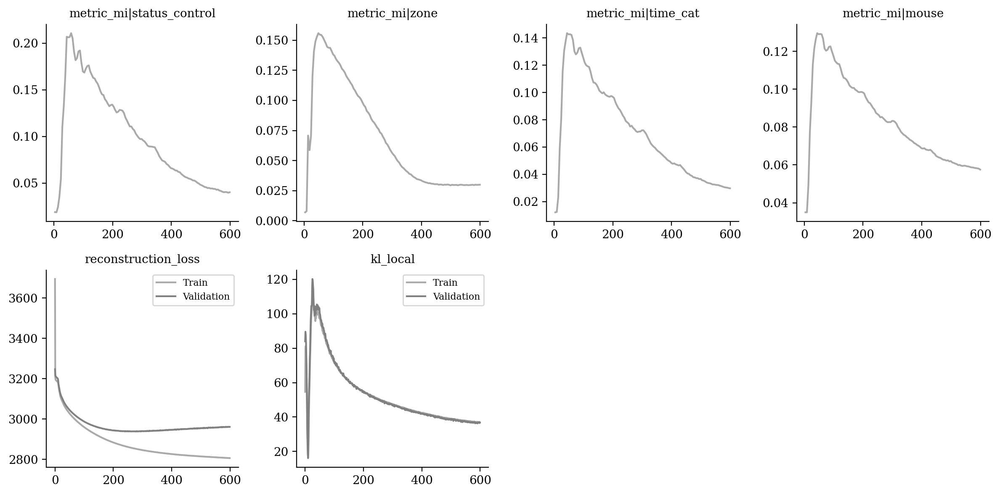

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

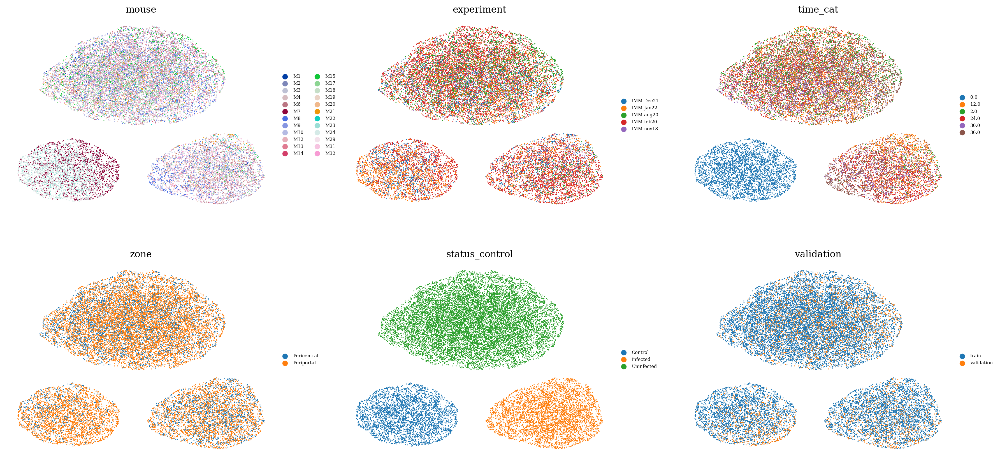

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

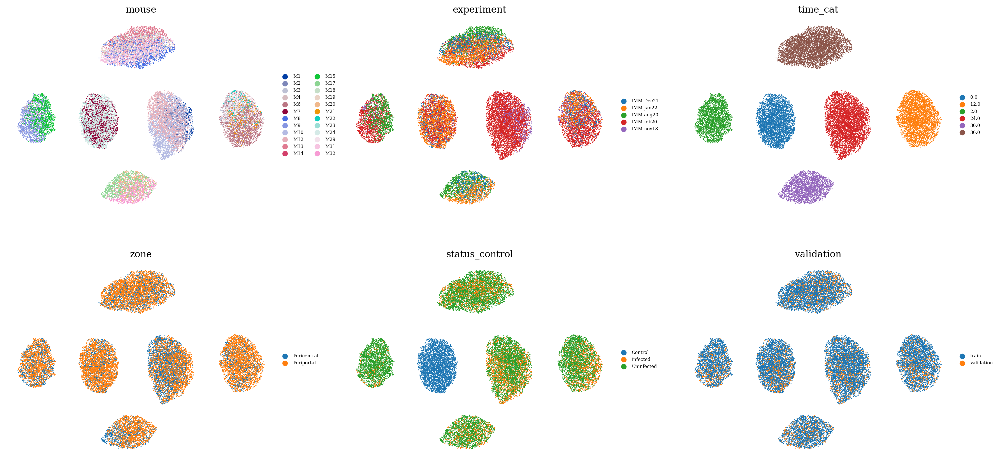

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

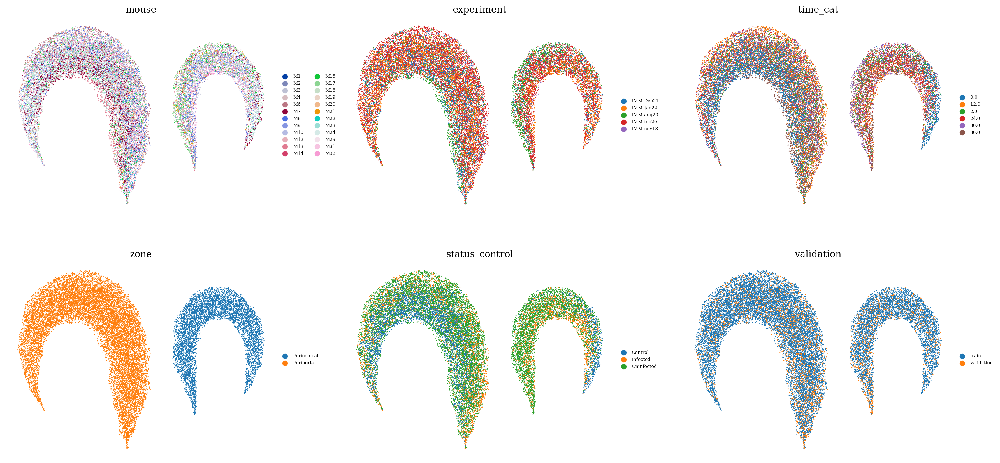

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

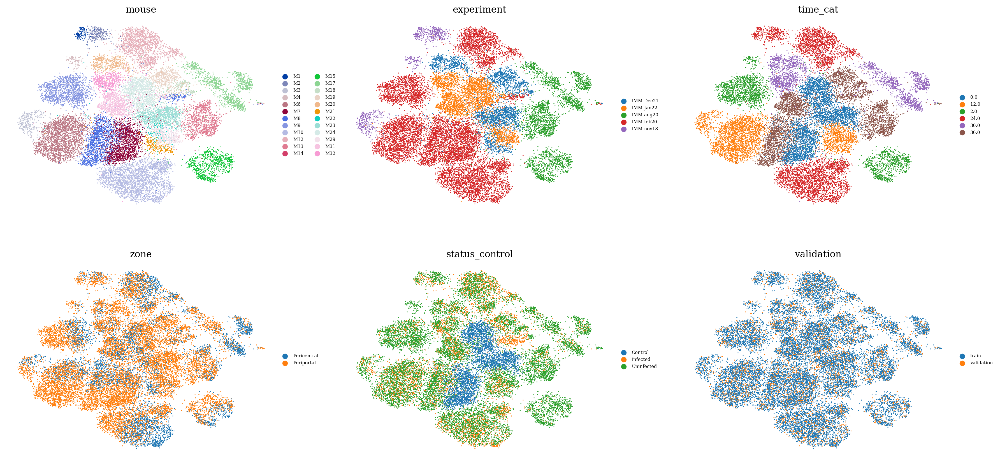

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

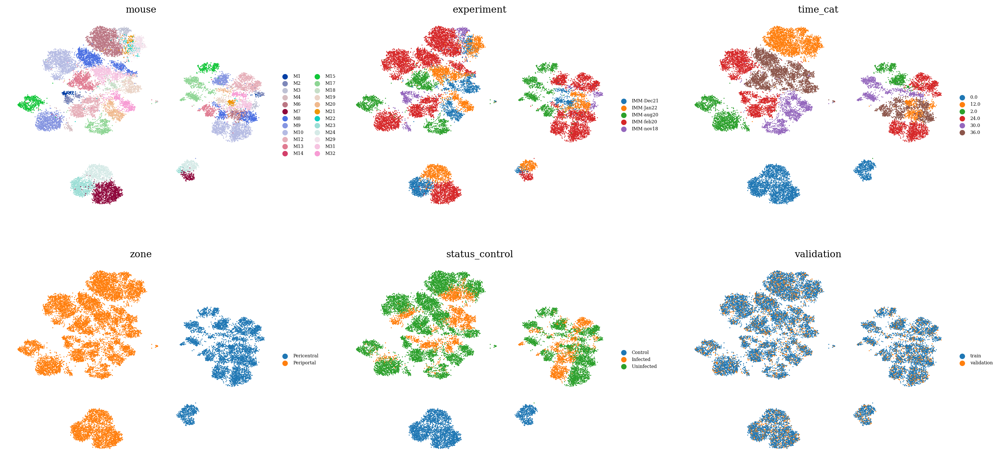

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

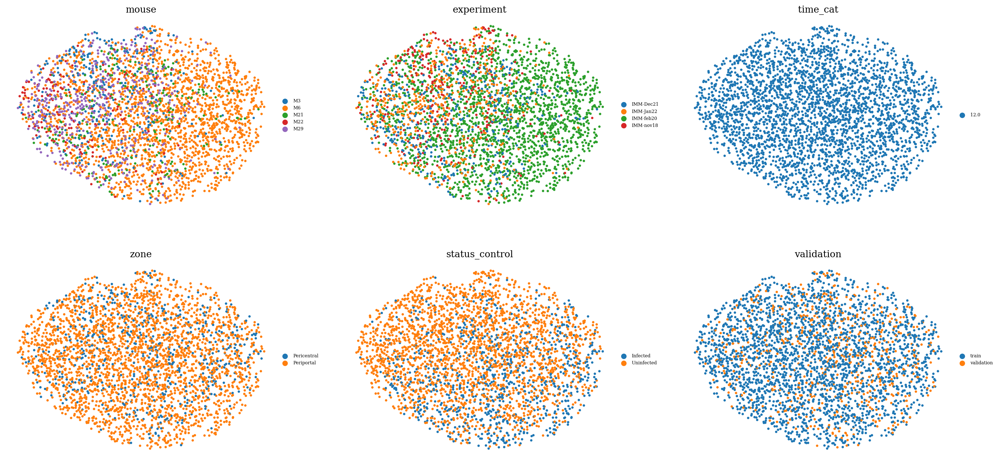

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )